# Computer Vision 2025 Assignment 1: Image filtering.

In this assignment, you will research, implement and test some image filtering operations. Image filtering by convolution is a fundamental step in many computer vision tasks and you will find it useful to have a firm grasp of how it works. For example, later in the course we will come across Convolutional Neural Networks (CNNs) which are built from convolutional image filters.

The main aims of the assignment are:

- to understand the basics of how images are stored and processed in memory;
- to gain exposure to several common image filters, and understand how they work;
- to get practical experience implementing convolutional image filters;
- to test your intuition about image filtering by running some experiments;
- to report your results in a clear and concise manner.

*This assignment relates to the following ACS CBOK areas: abstraction, design, hardware and software, data and information, HCI and programming.*

## General instructions

Follow the instructions in this Python notebook and the accompanying file *a1code.py* to answer each question. It's your responsibility to make sure your answer to each question is clearly labelled and easy to understand. Note that most questions require some combination of Python code, graphical output, and text analysing or describing your results. Although we will check your code as needed, marks will be assigned based on the quality of your write up rather than for code correctness! This is not a programming test - we are more interested in your understanding of the topic.

Only a small amount of code is required to answer each question. We will make extensive use of the Python libraries

- [numpy](numpy.org) for mathematical functions
- [skimage](https://scikit-image.org) for image loading and processing
- [matplotlib](https://matplotlib.org/stable/index.html) for displaying graphical results
- [jupyter](https://jupyter.org) for Jupyter Notebooks

You should get familiar with the documentation for these libraries so that you can use them effectively.

# The Questions

To get started, below is some setup code to import the libraries we need. You should not need to edit it.

In [1]:
# Numpy is the main package for scientific computing with Python.
import numpy as np

#from skimage import io

# Imports all the methods we define in the file a1code.py
from a1code import *

# Matplotlib is a useful plotting library for python
import matplotlib.pyplot as plt
# This code is to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

## Question 0: Numpy warm up! (Not Assesed. This part is for you to understand the basic of numpy)

Before starting the assignment, make sure you have a working Python 3 installation, with up to date versions of the libraries mentioned above. If this is all new to you, I'd suggest  downloading an all in one Python installation such as [Anaconda](https://www.anaconda.com/products/individual). Alternatively you can use a Python package manager such as pip or conda, to get the libraries you need. If you're struggling with this please ask a question on the MyUni discussion forum.

For this assignment, you need some familiarity with numpy syntax. The numpy QuickStart should be enough to get you started:

https://numpy.org/doc/stable/user/quickstart.html

Here are a few warm up exercises to make sure you understand the basics. Answer them in the space below. Be sure to print the output of each question so we can see it!

1. Create a 1D numpy array Z with 12 elements. Fill with values 1 to 12.
2. Reshape Z into a 2D numpy array A with 3 rows and 4 columns.
3. Reshape Z into a 2D numpy array B with 4 rows and 3 columns.
4. Calculate the *matrix* product of A and B.
5. Calculate the *element wise* product of $A$ and $B^T$ (B transpose).


In [2]:
# array from 1 to 12
z = np.array([1,2,3,4,5,6,7,8,9,10,11,12])
print(z)

# reshape z into a 3x4 matrix
a = z.reshape(3,4)
print(a)

# reshape z into a 4x3 matrix
b = z.reshape(4,3)
print(b)

# product of a and b
c = np.dot(a,b)
print(c)

# element-wise product of a and b
b_transpose = b.T
d = a*b_transpose
print(d)

[ 1  2  3  4  5  6  7  8  9 10 11 12]
[[ 1  2  3  4]
 [ 5  6  7  8]
 [ 9 10 11 12]]
[[ 1  2  3]
 [ 4  5  6]
 [ 7  8  9]
 [10 11 12]]
[[ 70  80  90]
 [158 184 210]
 [246 288 330]]
[[  1   8  21  40]
 [ 10  30  56  88]
 [ 27  60  99 144]]


You need to be comfortable with numpy arrays because that is how we store images. Let's do that next!

## Question 1: Loading and displaying an image (10%)

Below is a function to display an image using the pyplot module in matplotlib. Implement the `load()` and `print_stats()` functions in a1code.py so that the following code loads the mandrill image, displays it and prints its height, width and channel.

In [3]:
def display(img, caption=''):
    # Show image using pyplot
    plt.figure()
    plt.imshow(img)
    plt.title(caption)
    plt.axis('off')
    plt.show()

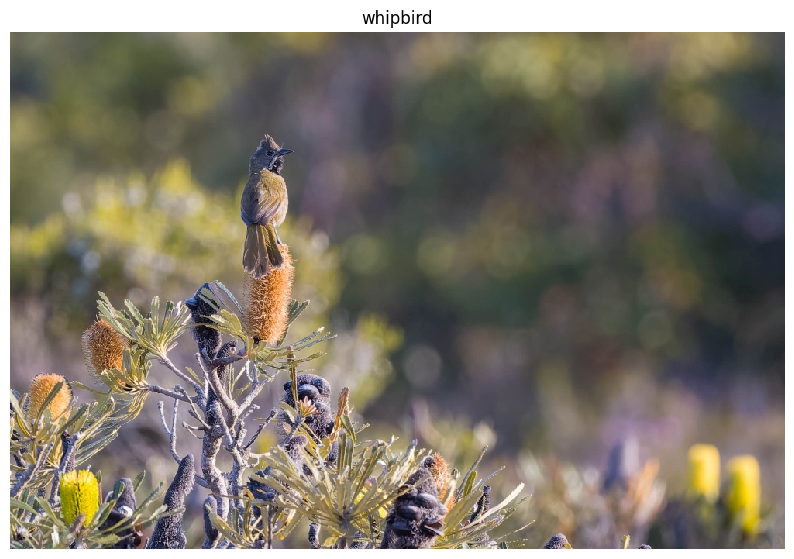

Height:  667
Width:  1000
Channels:  3


In [4]:
image1 = load('images/whipbird.jpg')

display(image1, 'whipbird')

print_stats(image1)

Return to this question after reading through the rest of the assignment. Find **at least 2 more images** to use as test cases in this assignment for all the following questions and display them below. Use your print_stats() function to display their height, width and number of channels. Explain *why* you have chosen each image.

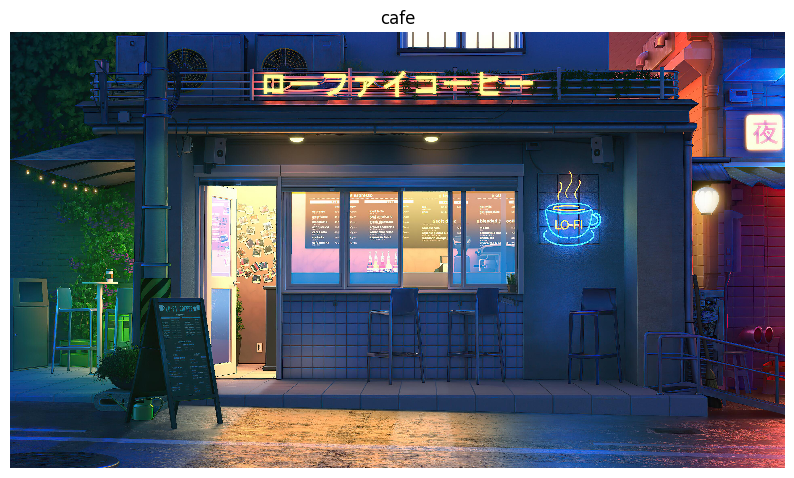

Height:  2160
Width:  3840
Channels:  3


In [5]:
### Your code to load and display your images here
image2 = load('images/cafe.jpg')
display(image2, 'cafe')
print_stats(image2)

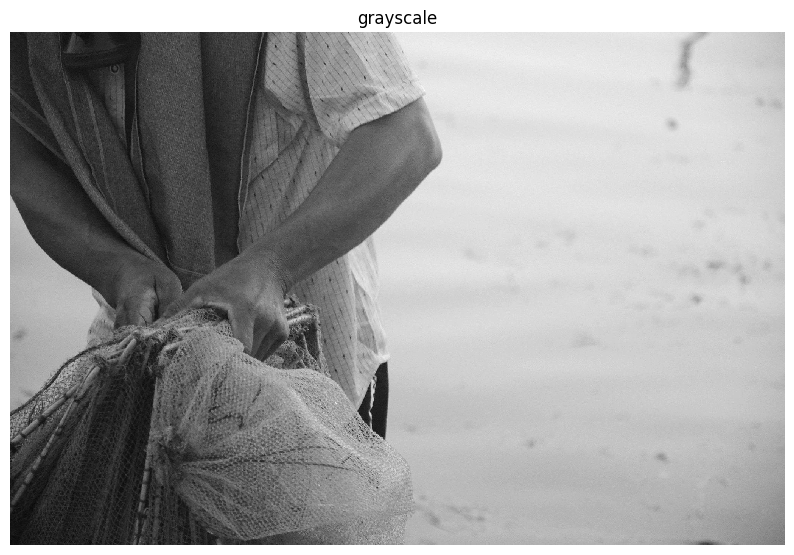

Height:  1356
Width:  2048
Channels: 1


In [6]:
image3 = load('images/grayscale.jpg')
display(image3, 'grayscale')
print_stats(image3)

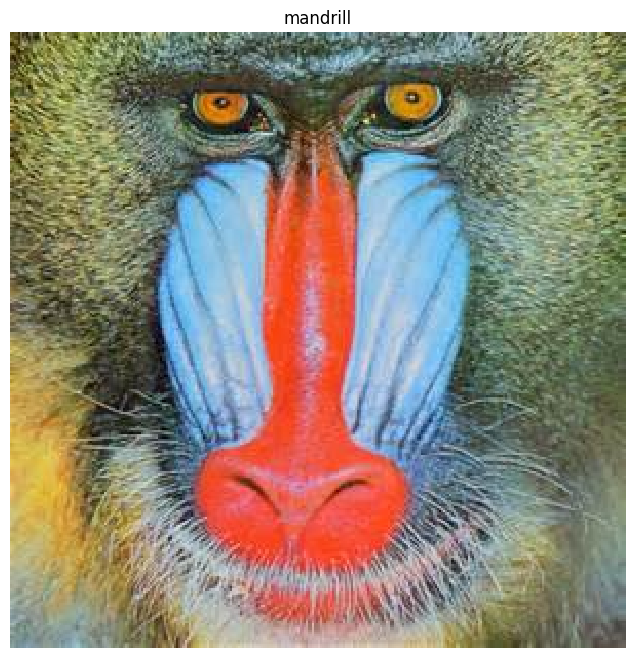

Height:  300
Width:  300
Channels:  3


In [7]:
image4 = load('images/mandrill.jpg')
display(image4, 'mandrill')
print_stats(image4)

***Your explanation of images here***

## Image choices explanation:

### 1. Whipbird
   - This image has both sharp details and blurred areas, allow me to test how filters handle edges and smooth backgrounds. The bird and plants are in focus and sharp, while the soft background helps analyze effects of filters on blurred areas.

### 2. Cafe
   - This image has bright neon lights and dark shadows, making it good for testing contrast adjustments and thresholding. The mix of bright and dark areas helps see how filters work with different colors and exposure.  
   - Additionally, this image contains many straight and horizontal edges, such as window frames, neon signs, and the building structure. These features make it ideal for testing edge detection filters.

### 3. Grayscale Fisherman
   - This is a grayscale image, which have no colour (black and white only) and focuses only on textures and brightness levels. It’s useful for testing edge detection and seeing how grayscale images behave with different filters.

### 4. Mandrill
   - This image has strong colours and contrast, which makes it useful for testing colour filters and brightness adjustments.
   - The detailed textures on the fur and face are helpful for seeing how edge detection and blurring filters affect fine details.

## Question 2: Image processing (30%)

Now that you have an image stored as a numpy array, let's try some operations on it.

1. Implement the `crop()` function in a1code.py. Use array slicing to crop the image.
2. Implement the `resize()` function in a1code.py.
3. Implement the `change_contrast()` function in a1code.py.
4. Implement the `greyscale()` function in a1code.py.
5. Implement the `binary()` function in a1code.py.

What do you observe when you change the threshold of the binary function?

Apply all these functions with different parameters on your own test images.

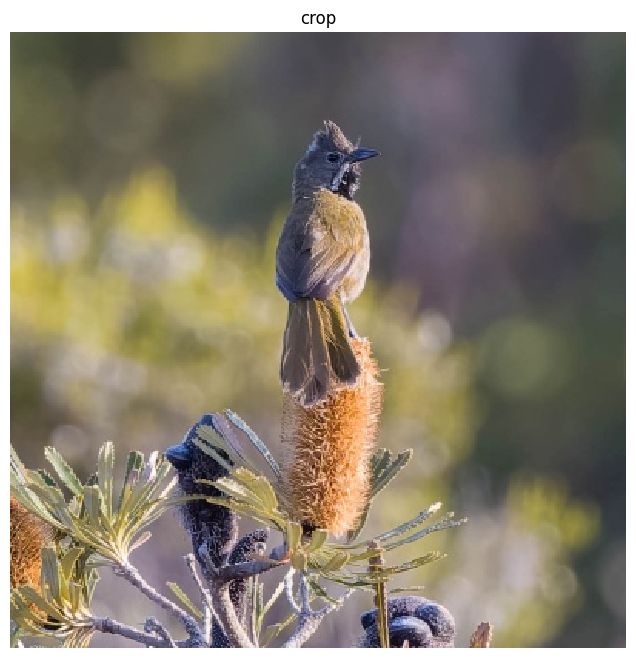

Height:  400
Width:  400
Channels:  3


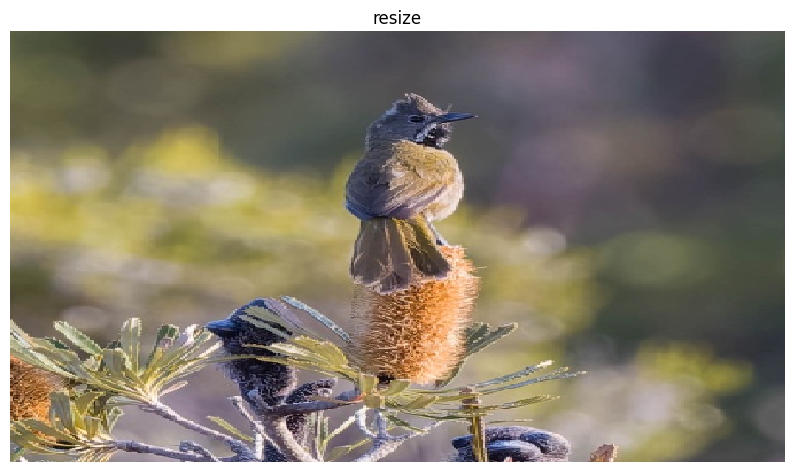

Height:  500
Width:  900
Channels:  3


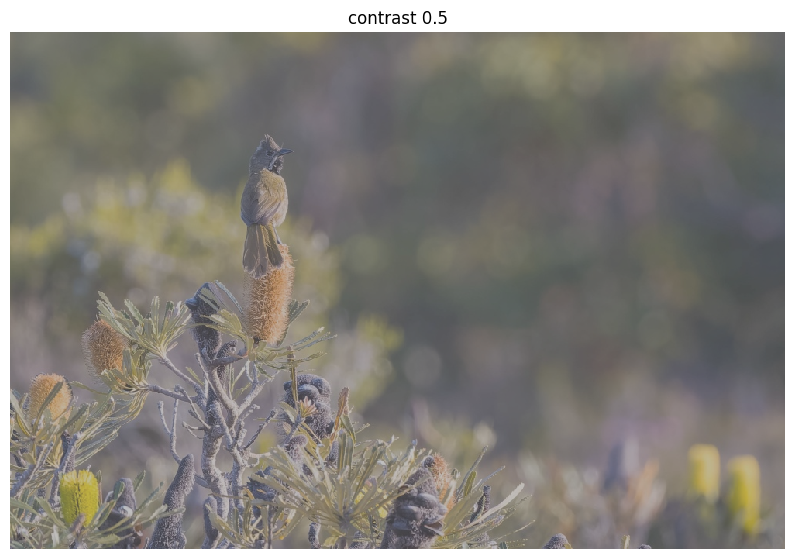

Height:  667
Width:  1000
Channels:  3


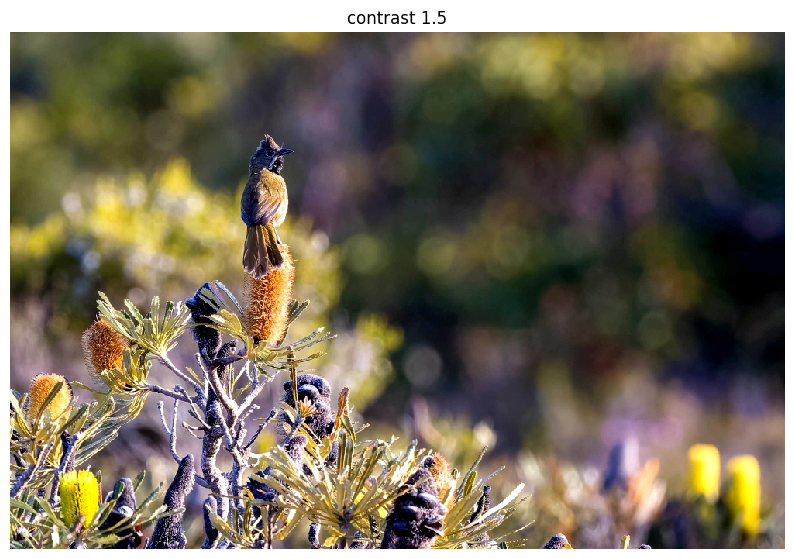

Height:  667
Width:  1000
Channels:  3


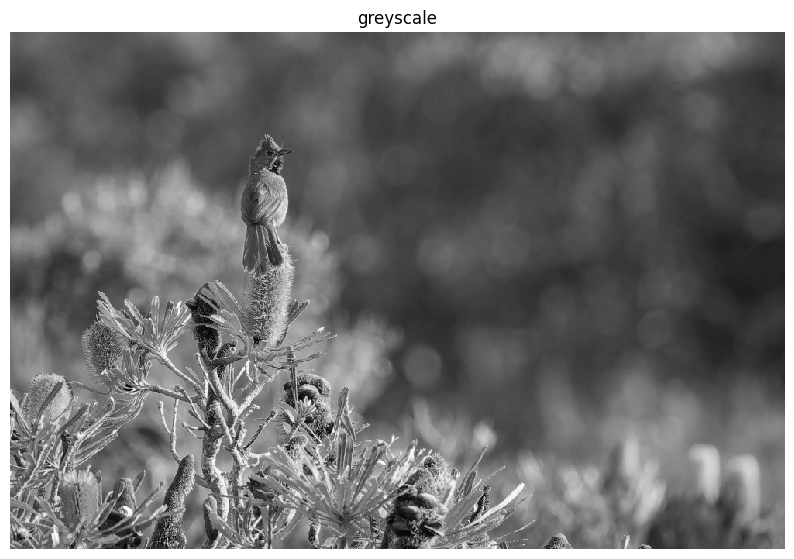

Height:  667
Width:  1000
Channels: 1


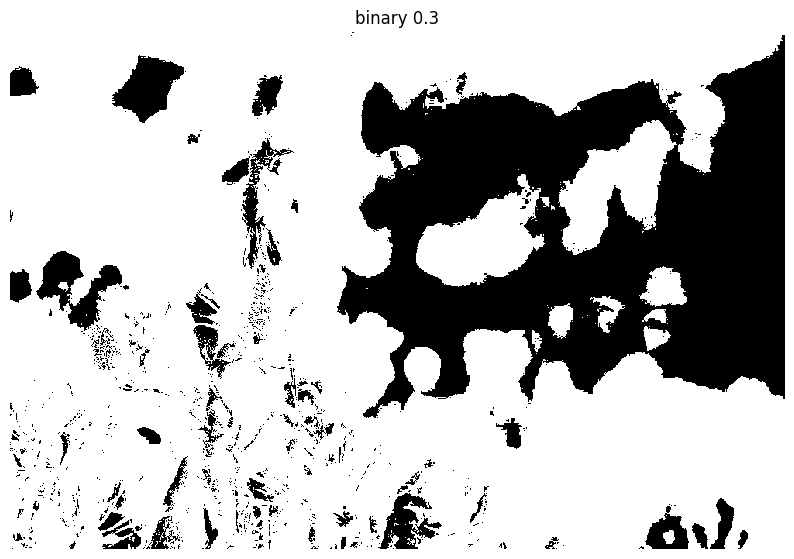

Height:  667
Width:  1000
Channels: 1


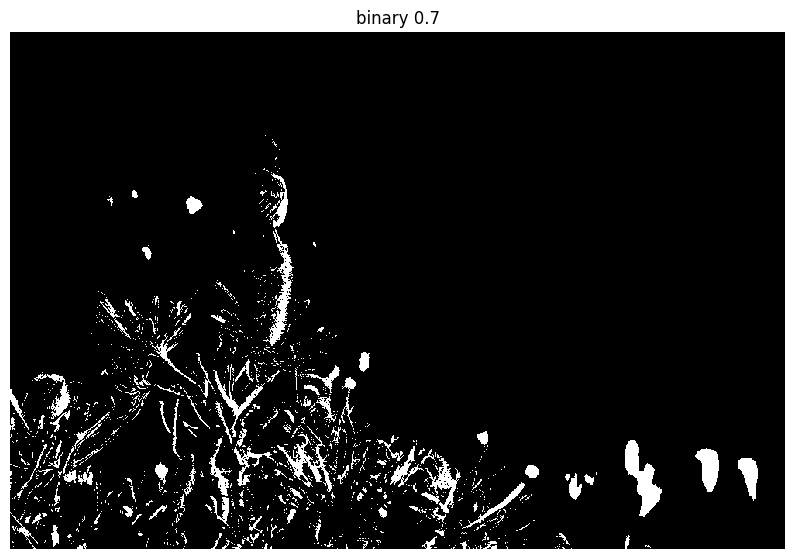

Height:  667
Width:  1000
Channels: 1


In [8]:
# This should crop the bird from the  image; you will need to adjust the parameters for the correct crop size and location
crop_img = crop(image1, 75, 125, 400, 400)
display(crop_img, 'crop')
print_stats(crop_img)

resize_img = resize(crop_img, 500, 900)
display(resize_img, 'resize')
print_stats(resize_img)

contrast_img = change_contrast(image1, 0.5)
display(contrast_img, 'contrast 0.5')
print_stats(contrast_img)

contrast_img = change_contrast(image1, 1.5)
display(contrast_img, 'contrast 1.5')
print_stats(contrast_img)

grey_img = greyscale(image1)
display(grey_img, 'greyscale')
print_stats(grey_img)

binary_img = binary(grey_img, 0.3)
display(binary_img, 'binary 0.3')
print_stats(binary_img)

binary_img = binary(grey_img, 0.7)
display(binary_img, 'binary 0.7')
print_stats(binary_img)


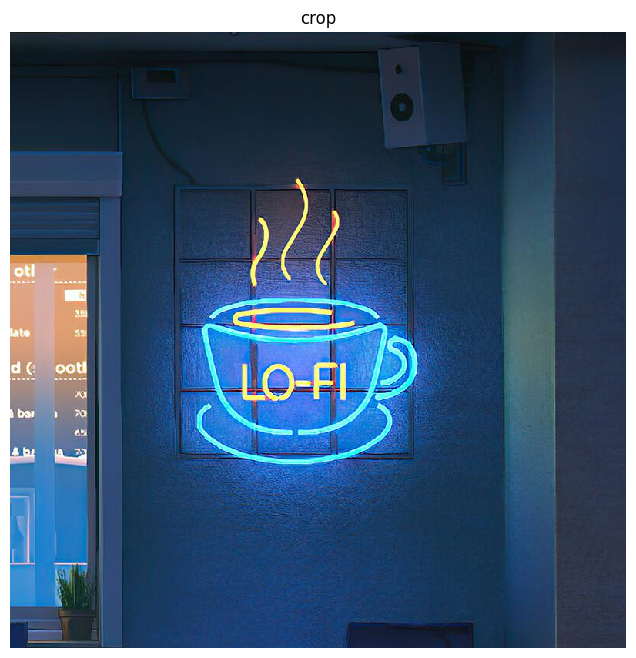

Height:  800
Width:  800
Channels:  3


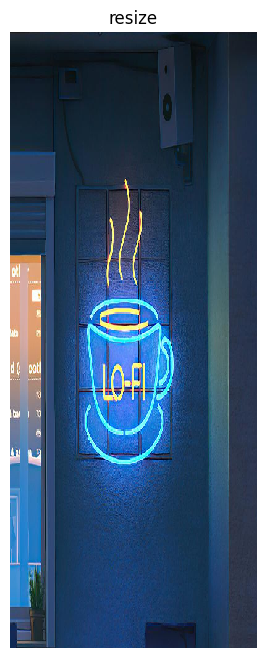

Height:  1000
Width:  400
Channels:  3


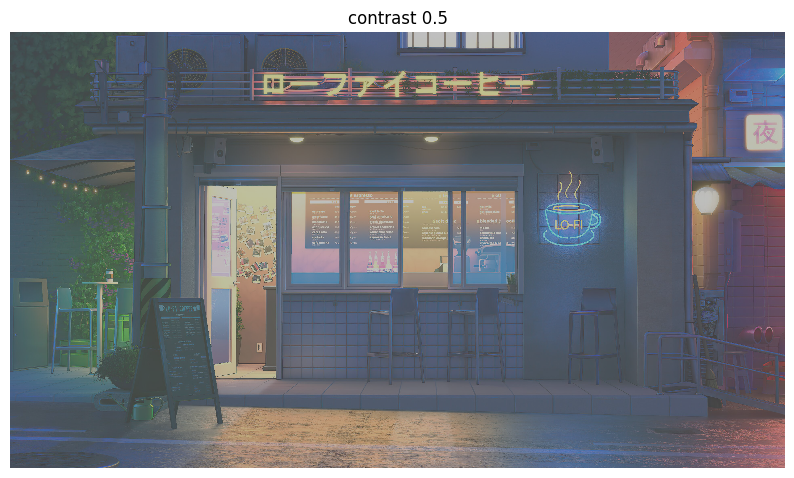

Height:  2160
Width:  3840
Channels:  3


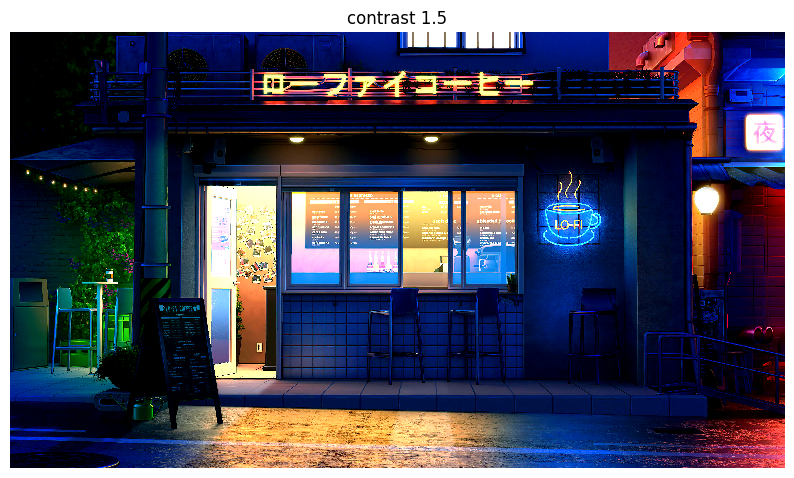

Height:  2160
Width:  3840
Channels:  3


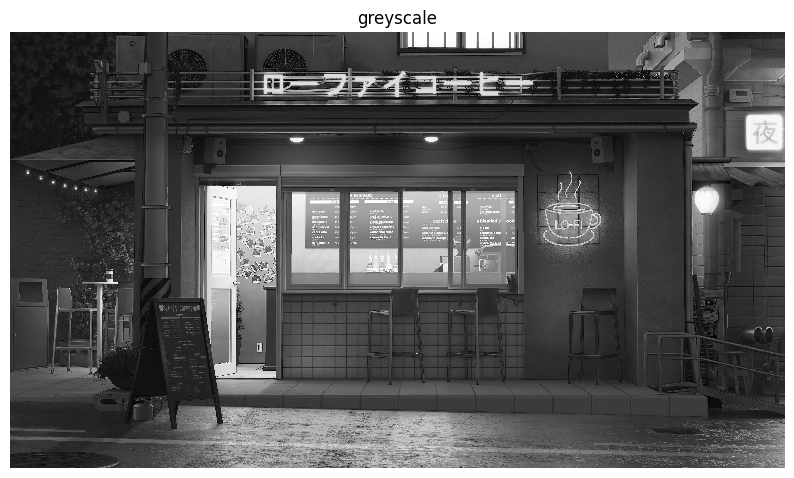

Height:  2160
Width:  3840
Channels: 1


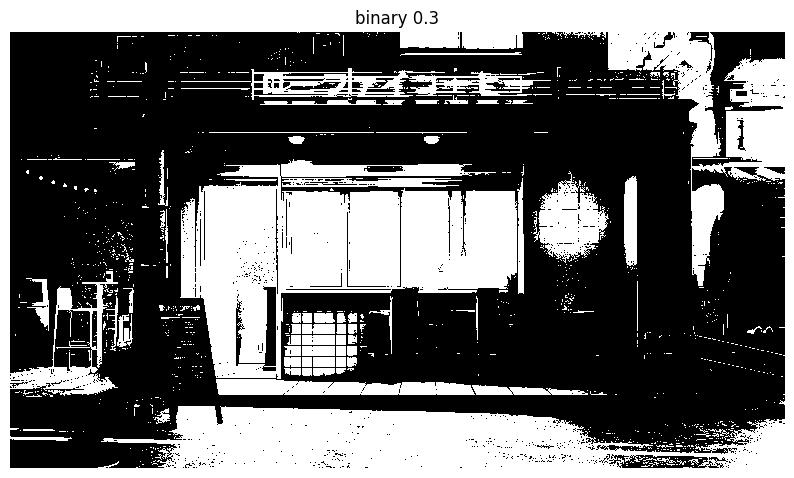

Height:  2160
Width:  3840
Channels: 1


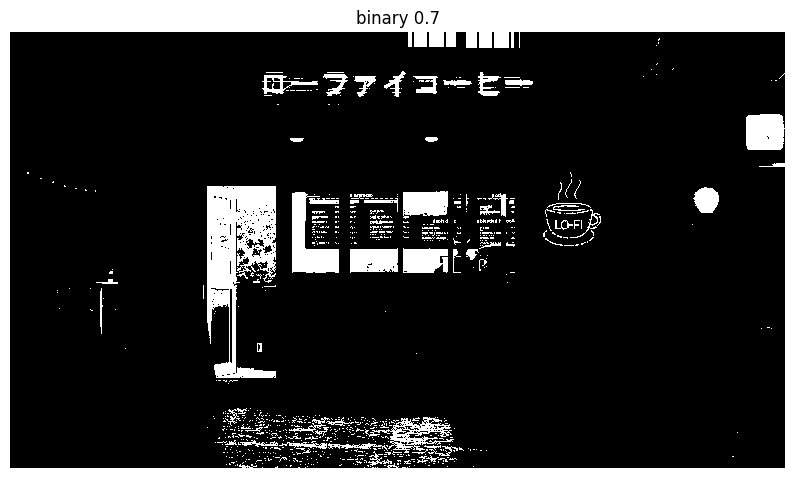

Height:  2160
Width:  3840
Channels: 1


In [9]:
# Cafe image
crop_img = crop(image2, 500, 2400, 800, 800)
display(crop_img, 'crop')
print_stats(crop_img)

resize_img = resize(crop_img, 1000, 400)
display(resize_img, 'resize')
print_stats(resize_img)

contrast_img = change_contrast(image2, 0.5)
display(contrast_img, 'contrast 0.5')
print_stats(contrast_img)

contrast_img = change_contrast(image2, 1.5)
display(contrast_img, 'contrast 1.5')
print_stats(contrast_img)

grey_img = greyscale(image2)
display(grey_img, 'greyscale')
print_stats(grey_img)

binary_img = binary(grey_img, 0.3)
display(binary_img, 'binary 0.3')
print_stats(binary_img)

binary_img = binary(grey_img, 0.7)
display(binary_img, 'binary 0.7')
print_stats(binary_img)


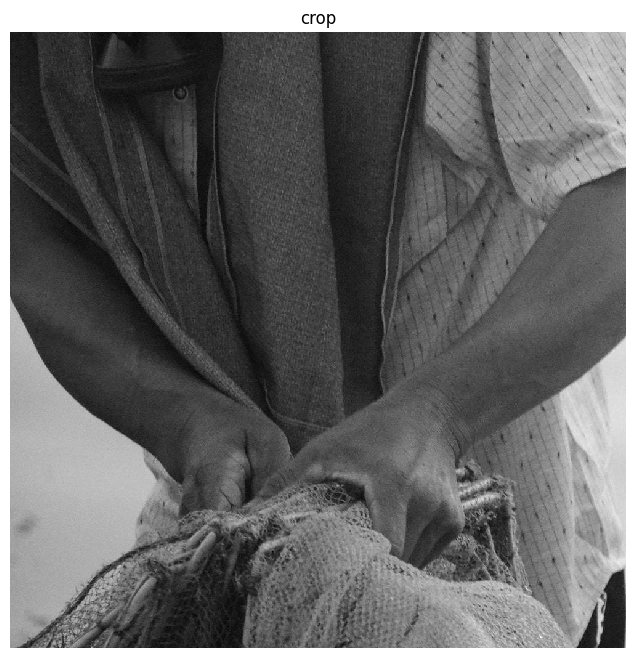

Height:  1000
Width:  1000
Channels: 1


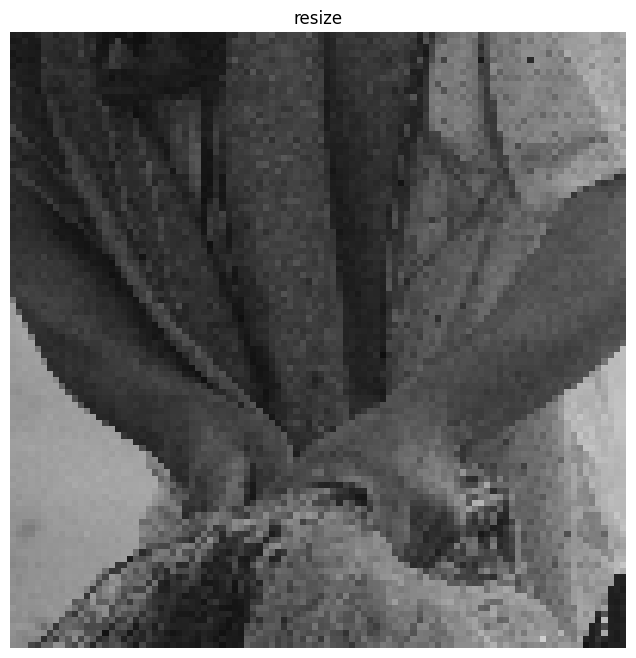

Height:  100
Width:  100
Channels:  3


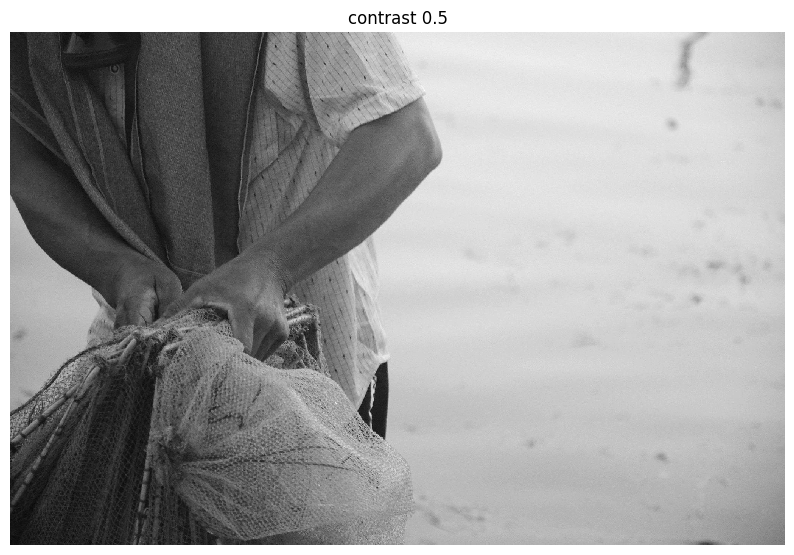

Height:  1356
Width:  2048
Channels: 1


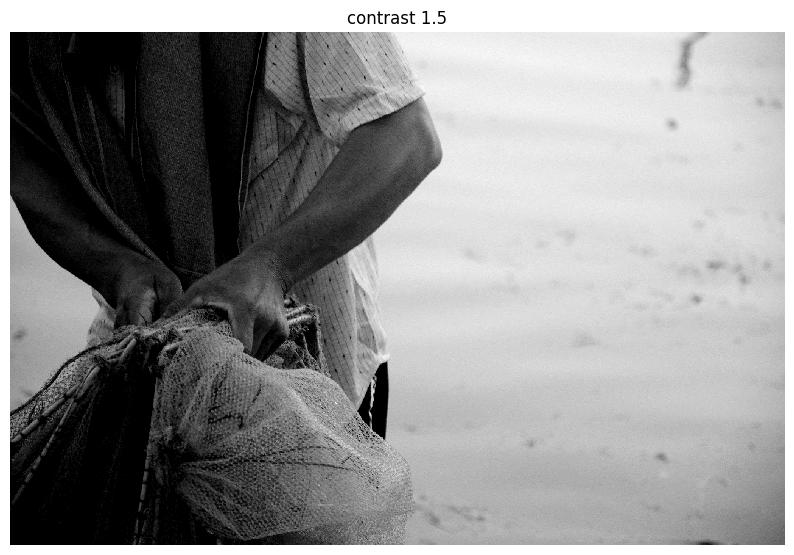

Height:  1356
Width:  2048
Channels: 1


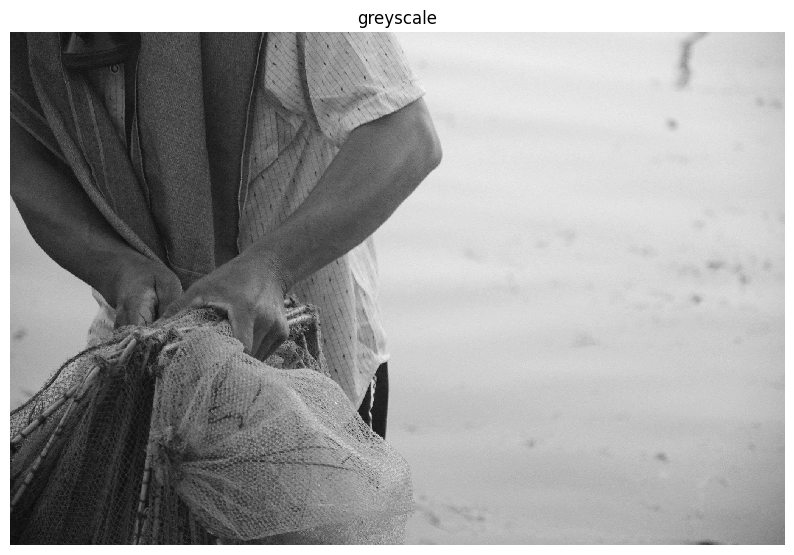

Height:  1356
Width:  2048
Channels: 1


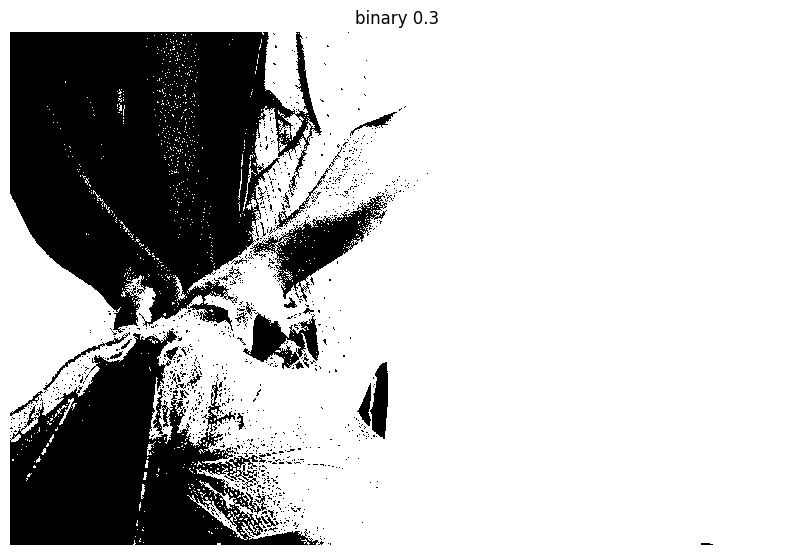

Height:  1356
Width:  2048
Channels: 1


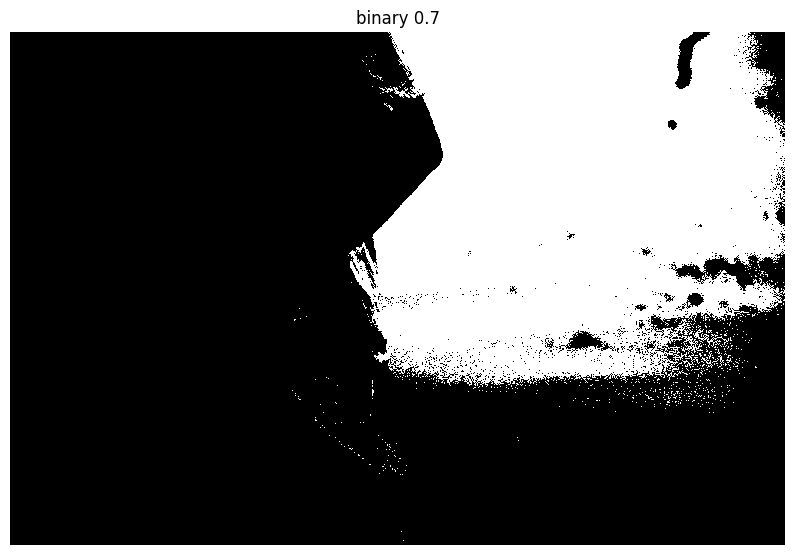

Height:  1356
Width:  2048
Channels: 1


In [10]:
# Fisherman image
crop_img = crop(image3, 0, 0, 1000, 1000)
display(crop_img, 'crop')
print_stats(crop_img)

resize_img = resize(crop_img, 100, 100)
display(resize_img, 'resize')
print_stats(resize_img)

contrast_img = change_contrast(image3, 0.5)
display(contrast_img, 'contrast 0.5')
print_stats(contrast_img)

contrast_img = change_contrast(image3, 1.5)
display(contrast_img, 'contrast 1.5')
print_stats(contrast_img)

grey_img = greyscale(image3)
display(grey_img, 'greyscale')
print_stats(grey_img)

binary_img = binary(grey_img, 0.3)
display(binary_img, 'binary 0.3')
print_stats(binary_img)

binary_img = binary(grey_img, 0.7)
display(binary_img, 'binary 0.7')
print_stats(binary_img)


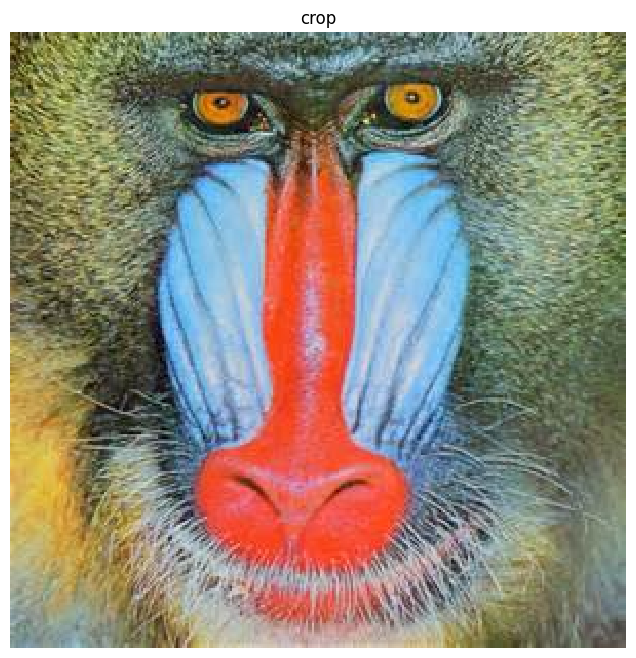

Height:  300
Width:  300
Channels:  3


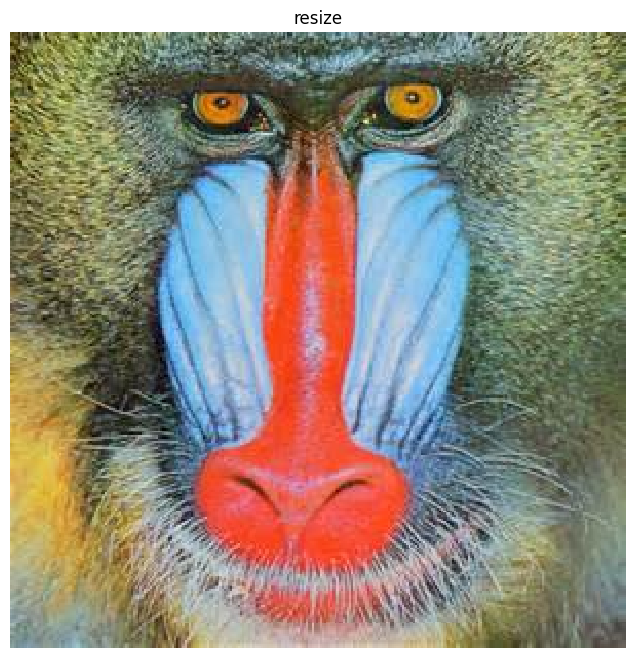

Height:  2000
Width:  2000
Channels:  3


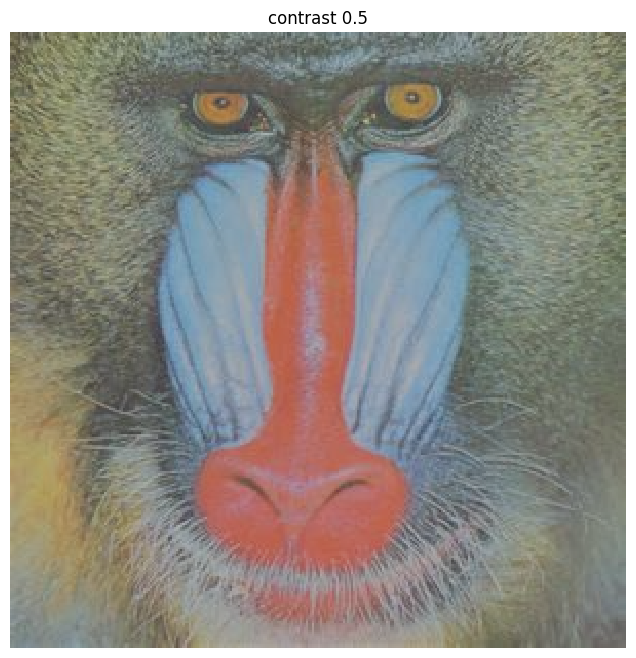

Height:  300
Width:  300
Channels:  3


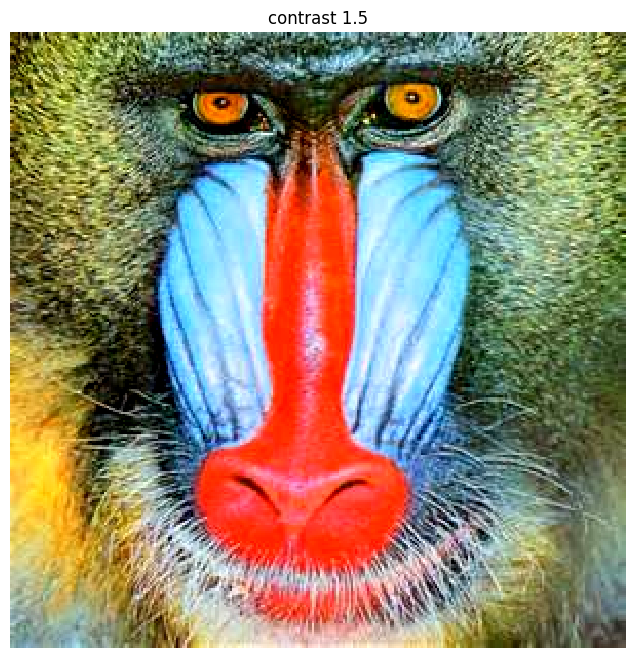

Height:  300
Width:  300
Channels:  3


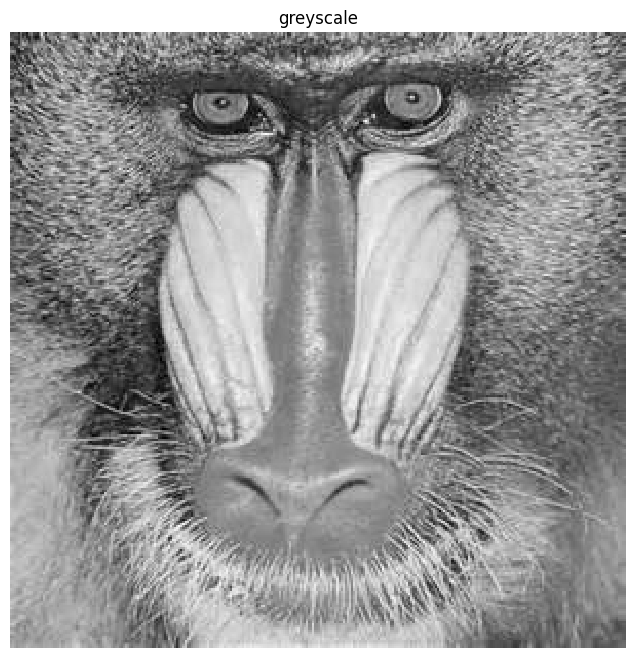

Height:  300
Width:  300
Channels: 1


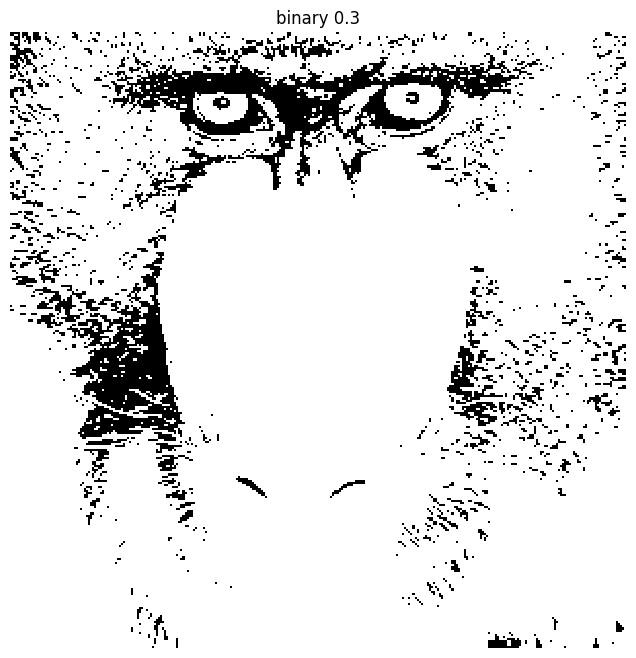

Height:  300
Width:  300
Channels: 1


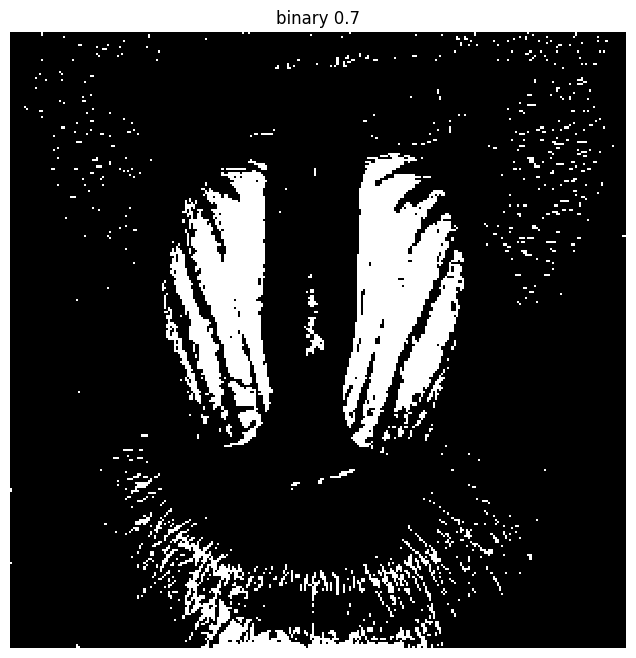

Height:  300
Width:  300
Channels: 1


In [11]:
# Mandrill image
crop_img = crop(image4, 0, 0, 1000, 1000)
display(crop_img, 'crop')
print_stats(crop_img)

resize_img = resize(crop_img, 2000, 2000)
display(resize_img, 'resize')
print_stats(resize_img)

contrast_img = change_contrast(image4, 0.5)
display(contrast_img, 'contrast 0.5')
print_stats(contrast_img)

contrast_img = change_contrast(image4, 1.5)
display(contrast_img, 'contrast 1.5')
print_stats(contrast_img)

grey_img = greyscale(image4)
display(grey_img, 'greyscale')
print_stats(grey_img)

binary_img = binary(grey_img, 0.3)
display(binary_img, 'binary 0.3')
print_stats(binary_img)

binary_img = binary(grey_img, 0.7)
display(binary_img, 'binary 0.7')
print_stats(binary_img)

## Question 3: Convolution (30%)

### 3.1(a) 2D convolution

Using the definition of 2D convolution from week 1, implement the convolution operation in the function `conv2D()` in a1code.py.


In [12]:
test_conv2D()

### 3.1(b) RGB convolution

In the function `conv` in a1code.py, extend your function `conv2D` to work on RGB images, by applying the 2D convolution to each channel independently.

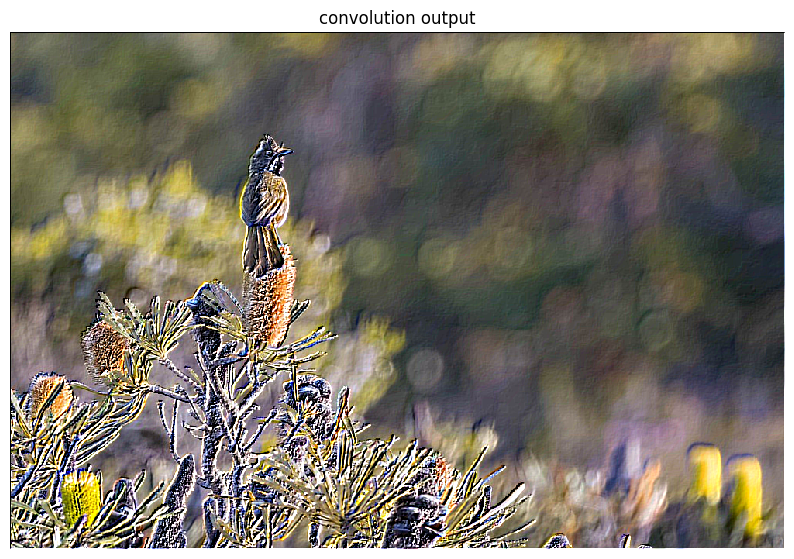

Height:  667
Width:  1000
Channels:  3


In [13]:
# sample kernel (Emboss filter)
kernel = np.array([[-2, -1, 0], 
                   [-1, 1, 1], 
                   [0, 1, 2]])

image1 = load('images/whipbird.jpg')

test_output = conv(image1, kernel)

display(test_output, 'convolution output')
print_stats(test_output)

### 3.2 Gaussian filter convolution

Use the `gauss2D` function provided in a1code.py to create a Gaussian kernel, and apply it to your images with convolution. You will obtain marks for trying different tests and analysing the results, for example:

- try varying the image size, and the size and variance of the filter  
- subtract the filtered image from the original - this gives you an idea of what information is lost when filtering

What do you observe and why?

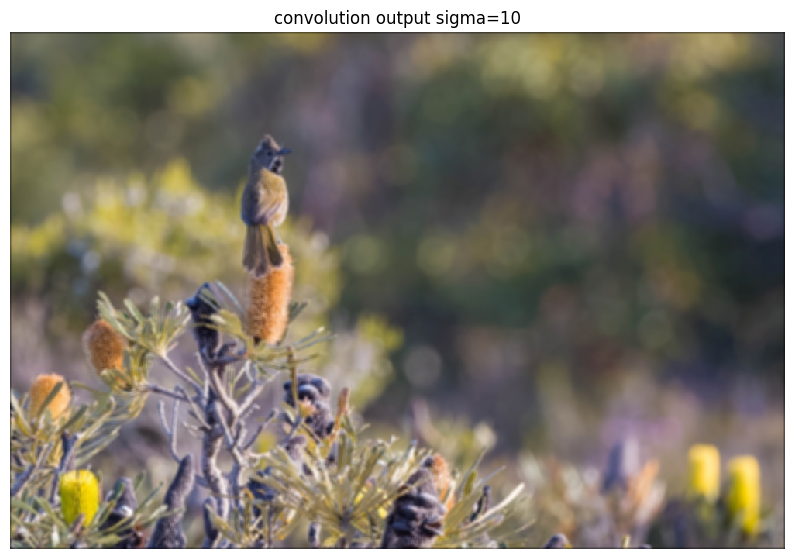

Height:  667
Width:  1000
Channels:  3


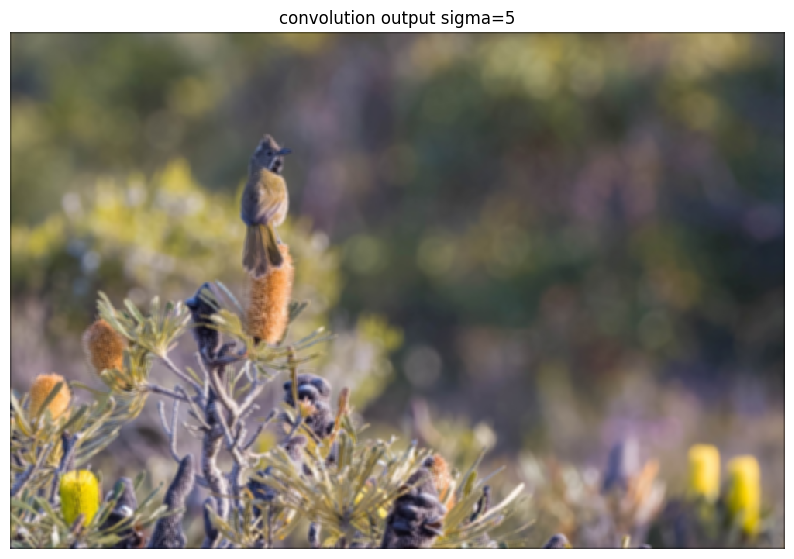

Height:  667
Width:  1000
Channels:  3


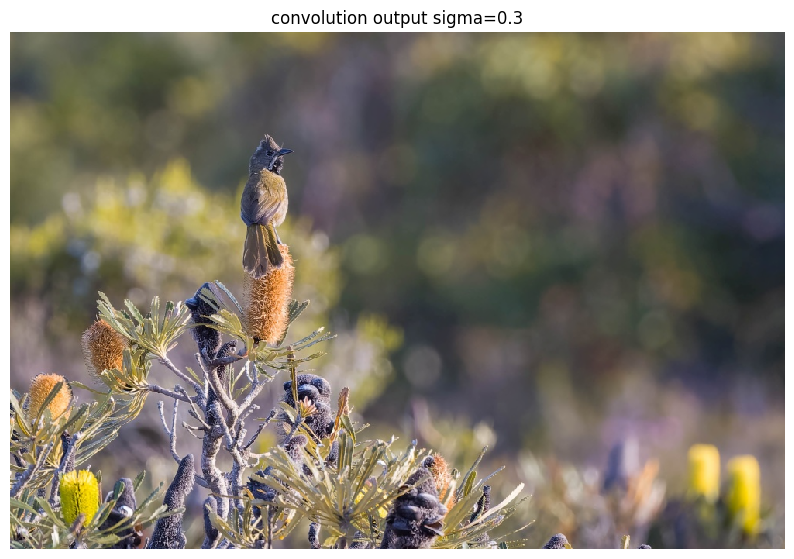

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.4227744583463843..0.5876170105487136].


Height:  667
Width:  1000
Channels:  3


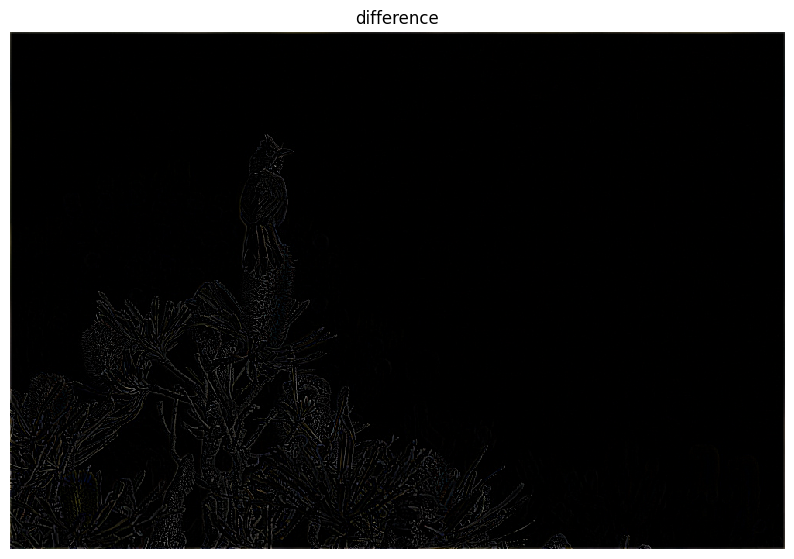

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.4186044390129724..0.5847622279919726].


Height:  667
Width:  1000
Channels:  3


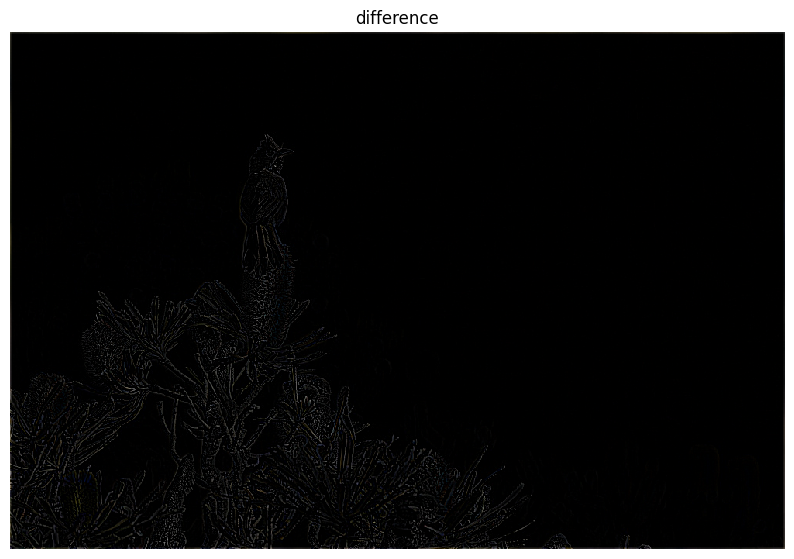

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.006065179473041971..0.006973080718231661].


Height:  667
Width:  1000
Channels:  3


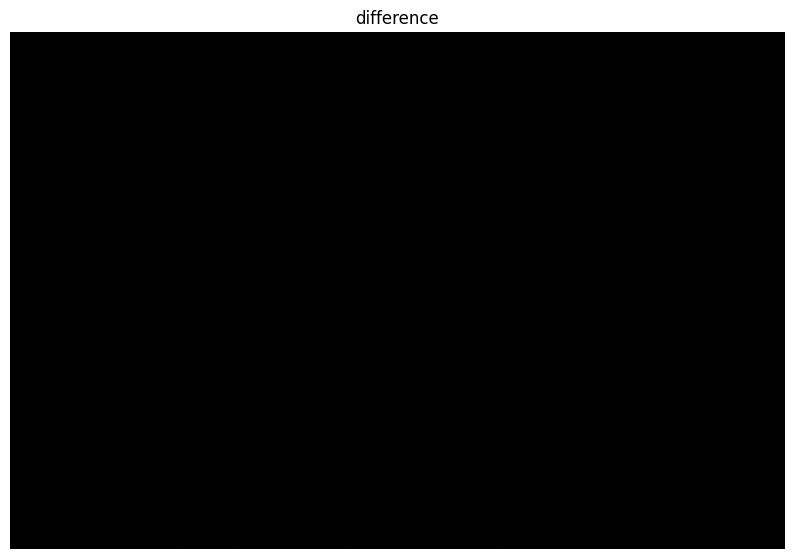

Height:  667
Width:  1000
Channels:  3


In [14]:
guassian_kernel_5_10 = gauss2D(5, 10)
guassian_kernel_5_5 = gauss2D(5, 5)
guassian_kernel_5_0 = gauss2D(5, 0.3)

image1 = load('images/whipbird.jpg')

test_output1 = conv(image1, guassian_kernel_5_10)
test_output2 = conv(image1, guassian_kernel_5_5)
test_output0 = conv(image1, guassian_kernel_5_0)

display(test_output1, 'convolution output sigma=10')
print_stats(test_output1)

display(test_output2, 'convolution output sigma=5')
print_stats(test_output2)

display(test_output0, 'convolution output sigma=0.3')
print_stats(test_output0)

# difference compared to the original image
diff1 = image1 - test_output1
display(diff1, 'difference')
print_stats(diff1)

diff2 = image1 - test_output2
display(diff2, 'difference')
print_stats(diff2)

diff0 = image1 - test_output0
display(diff0, 'difference')
print_stats(diff0)



### 3.3 Sobel filters

Define a horizontal and vertical Sobel edge filter kernel and test them on your images. You will obtain marks for testing them and displaying results in interesting ways, for example:

- apply them to an image at different scales
- considering how to display positive and negative gradients
- apply different combinations of horizontal and vertical filters as asked in the Assignment sheet.

In [15]:
# Sobel edge detection kernels
sobel_vertical = np.array([[1, 0, -1], 
                           [2, 0, -2], 
                           [1, 0, -1]])

sobel_horizontal = np.array([[1, 2, 1],
                             [0, 0, 0],
                             [-1, -2, -1]])

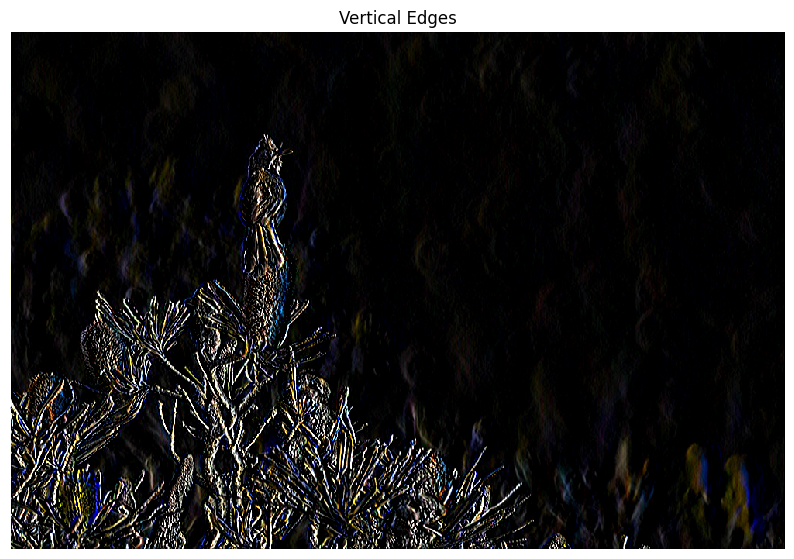

Height:  667
Width:  1000
Channels:  3


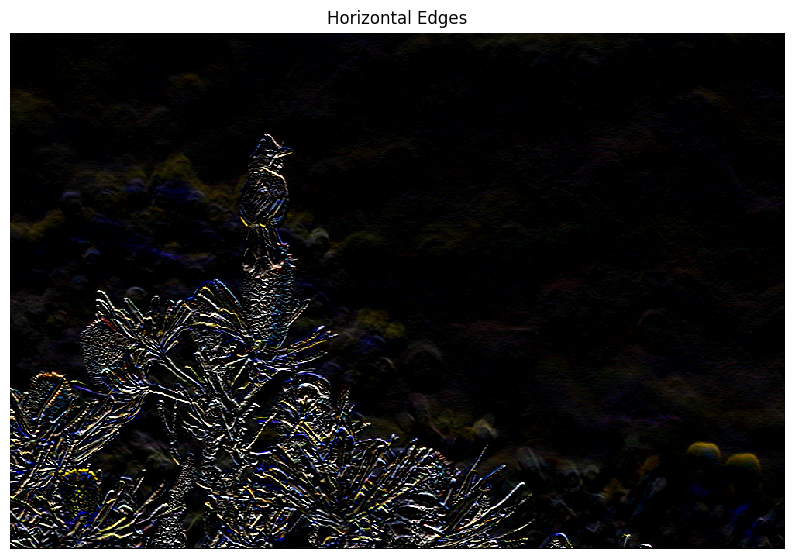

Height:  667
Width:  1000
Channels:  3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.4142135623730951].


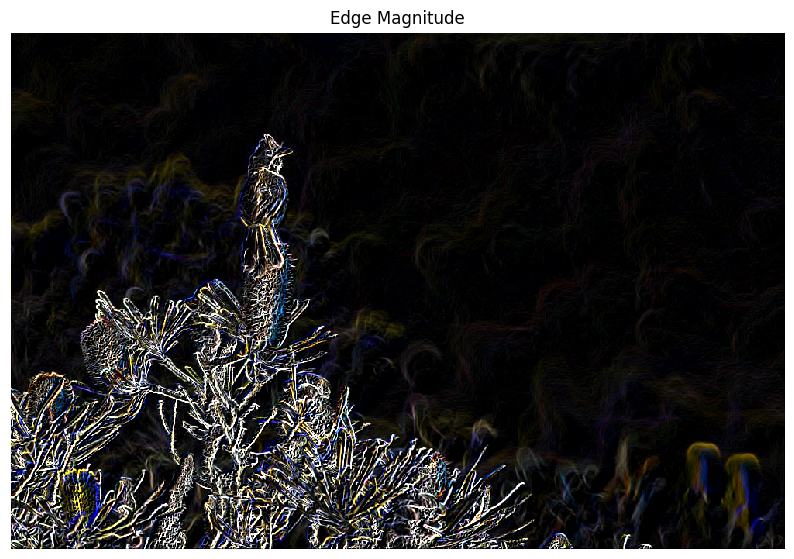

Height:  667
Width:  1000
Channels:  3


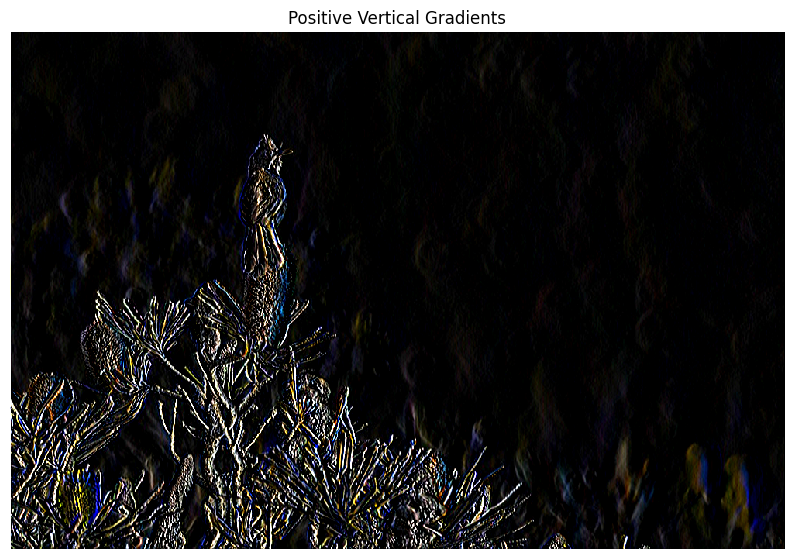

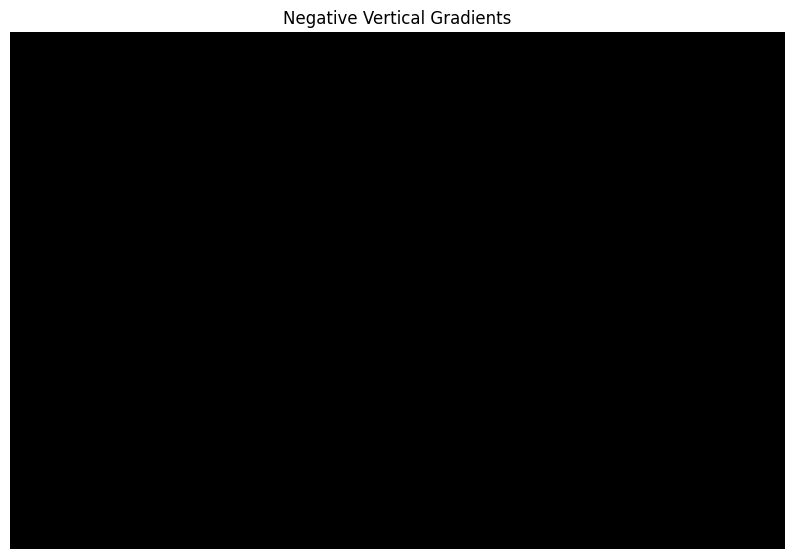

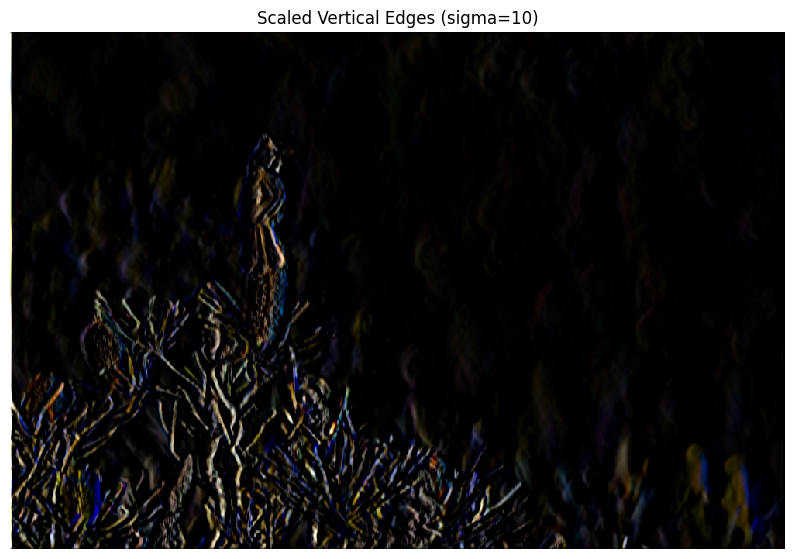

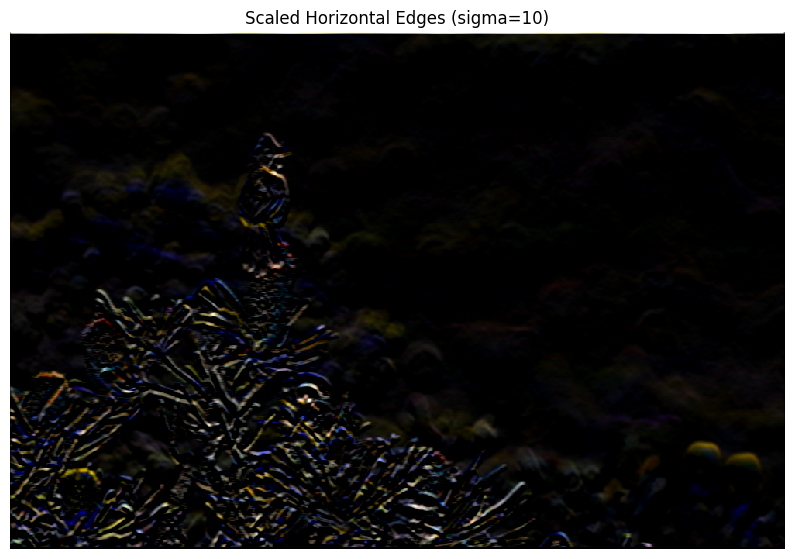

In [16]:
# Apply Sobel filters to image1
vertical_edges = conv(image1, sobel_vertical)
horizontal_edges = conv(image1, sobel_horizontal)

# Display results
display(vertical_edges, 'Vertical Edges')
print_stats(vertical_edges)

display(horizontal_edges, 'Horizontal Edges')
print_stats(horizontal_edges)

# Combine vertical and horizontal edges
edge_magnitude = np.sqrt(vertical_edges**2 + horizontal_edges**2)
edge_direction = np.arctan2(vertical_edges, horizontal_edges)

# Display combined results
display(edge_magnitude, 'Edge Magnitude')
print_stats(edge_magnitude)

# Display positive and negative gradients separately
positive_vertical = np.maximum(vertical_edges, 0)
negative_vertical = np.minimum(vertical_edges, 0)

display(positive_vertical, 'Positive Vertical Gradients')
display(negative_vertical, 'Negative Vertical Gradients')

# Apply at different scales by first blurring
blurred_image = conv(image1, guassian_kernel_5_10)
scaled_vertical = conv(blurred_image, sobel_vertical)
scaled_horizontal = conv(blurred_image, sobel_horizontal)

display(scaled_vertical, 'Scaled Vertical Edges (sigma=10)')
display(scaled_horizontal, 'Scaled Horizontal Edges (sigma=10)')


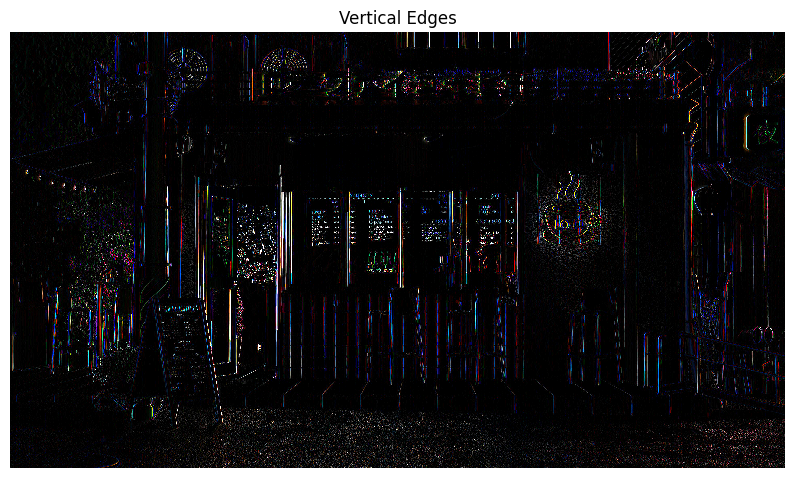

Height:  2160
Width:  3840
Channels:  3


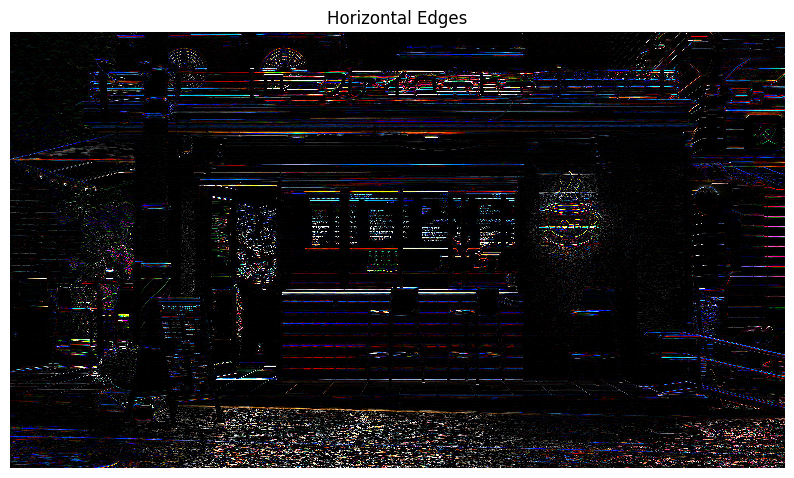

Height:  2160
Width:  3840
Channels:  3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.4142135623730951].


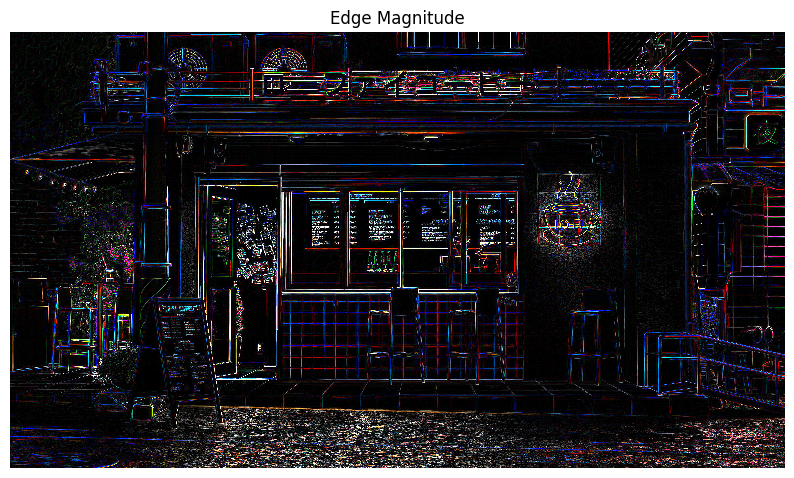

Height:  2160
Width:  3840
Channels:  3


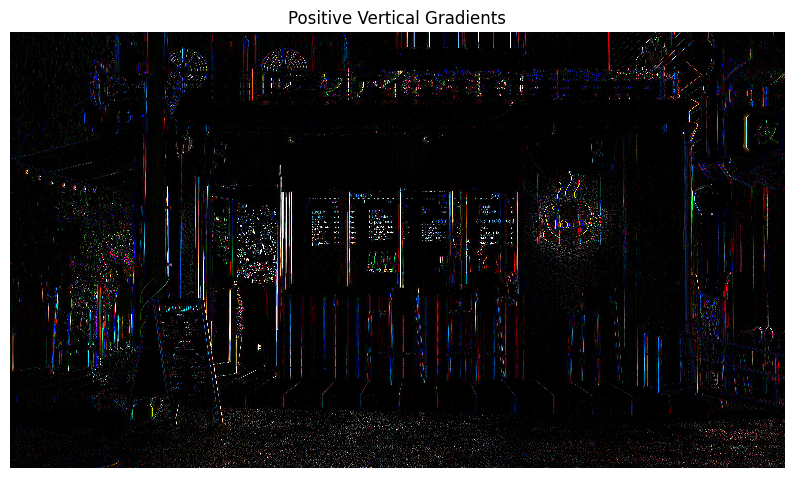

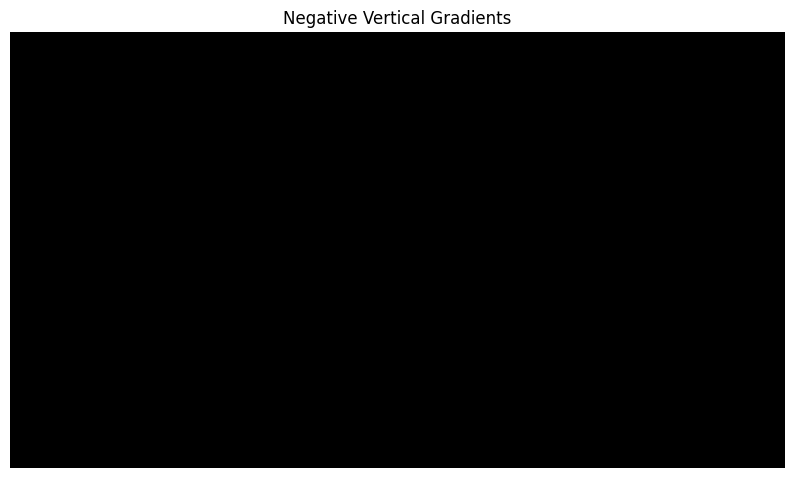

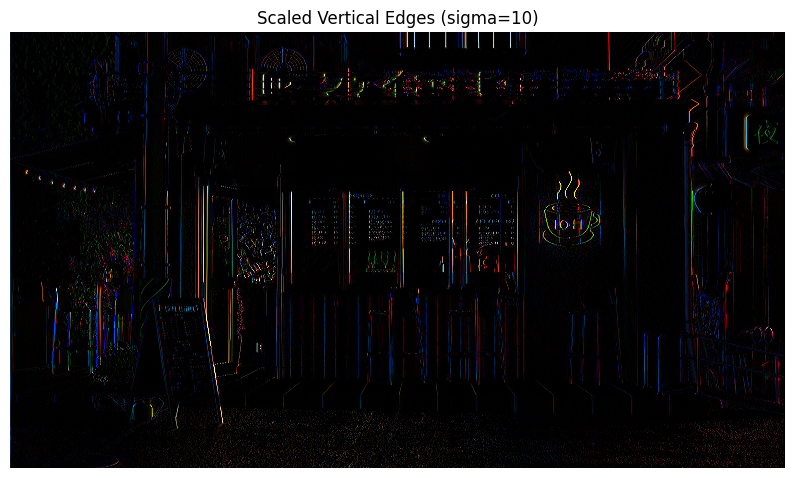

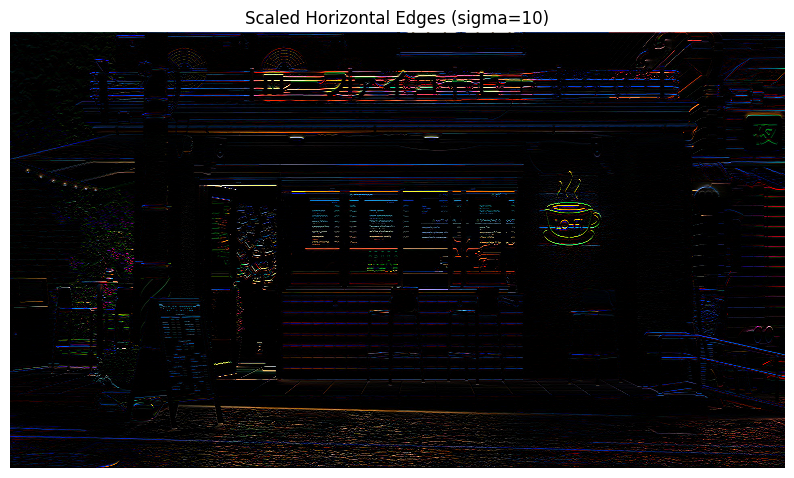

In [17]:
# Apply Sobel filters to image1
vertical_edges = conv(image2, sobel_vertical)
horizontal_edges = conv(image2, sobel_horizontal)

# Display results
display(vertical_edges, 'Vertical Edges')
print_stats(vertical_edges)

display(horizontal_edges, 'Horizontal Edges')
print_stats(horizontal_edges)

# Combine vertical and horizontal edges
edge_magnitude = np.sqrt(vertical_edges**2 + horizontal_edges**2)
edge_direction = np.arctan2(vertical_edges, horizontal_edges)

# Display combined results
display(edge_magnitude, 'Edge Magnitude')
print_stats(edge_magnitude)

# Display positive and negative gradients separately
positive_vertical = np.maximum(vertical_edges, 0)
negative_vertical = np.minimum(vertical_edges, 0)

display(positive_vertical, 'Positive Vertical Gradients')
display(negative_vertical, 'Negative Vertical Gradients')

# Apply at different scales by first blurring
blurred_image = conv(image2, guassian_kernel_5_5)
scaled_vertical = conv(blurred_image, sobel_vertical)
scaled_horizontal = conv(blurred_image, sobel_horizontal)

display(scaled_vertical, 'Scaled Vertical Edges (sigma=10)')
display(scaled_horizontal, 'Scaled Horizontal Edges (sigma=10)')


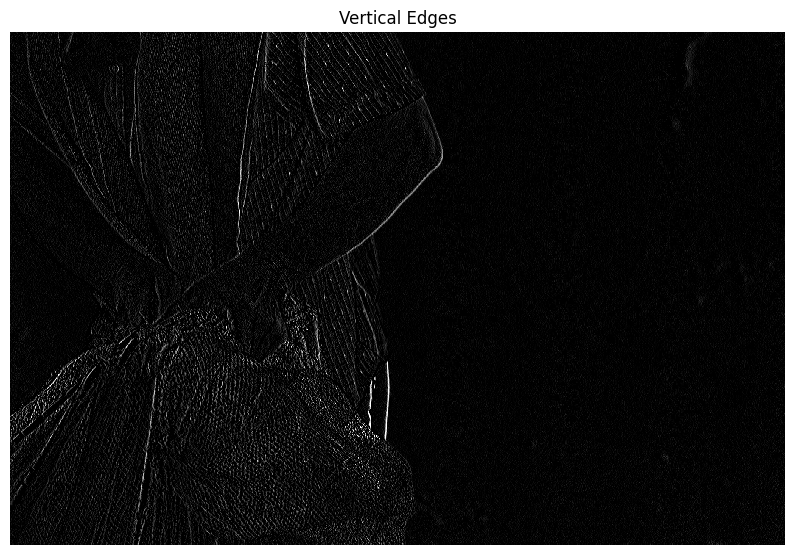

Height:  1356
Width:  2048
Channels: 1


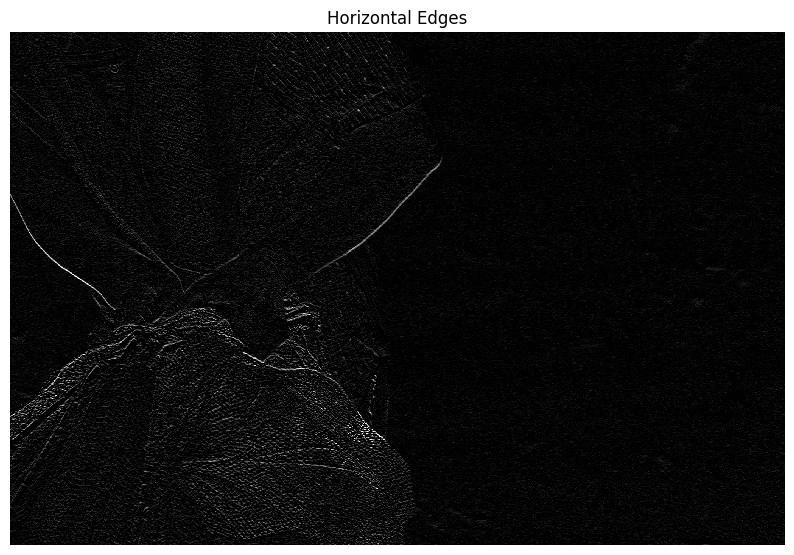

Height:  1356
Width:  2048
Channels: 1


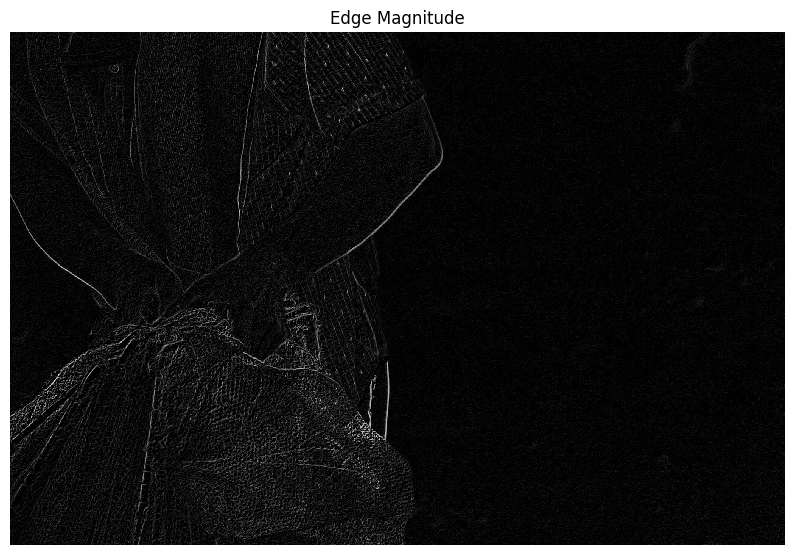

Height:  1356
Width:  2048
Channels: 1


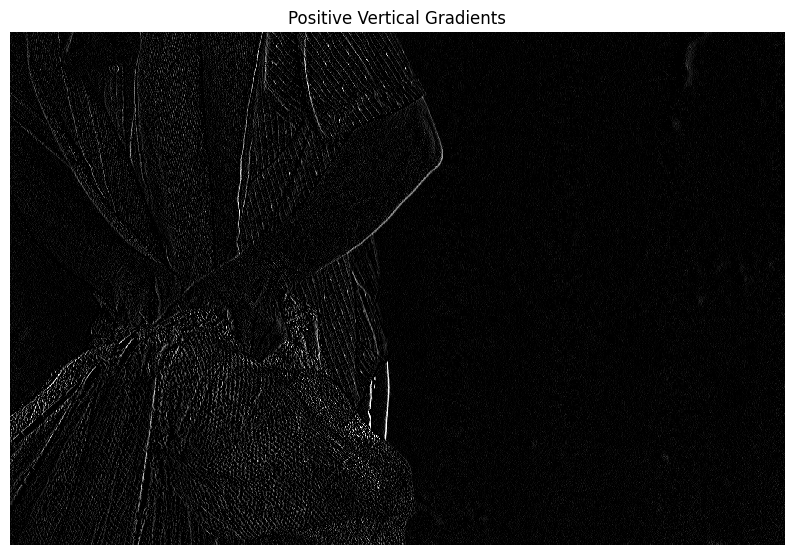

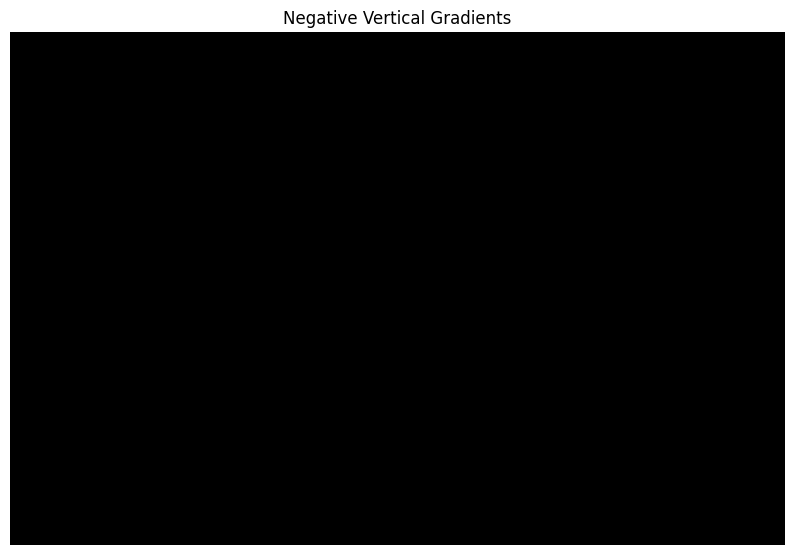

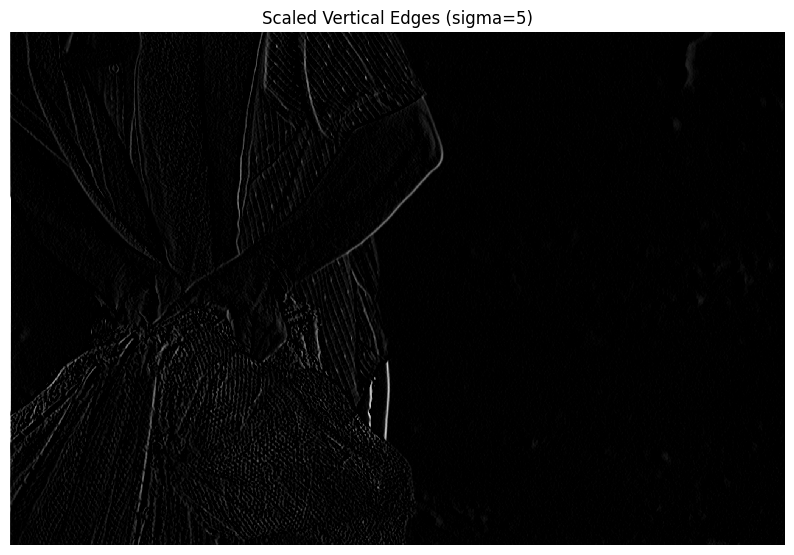

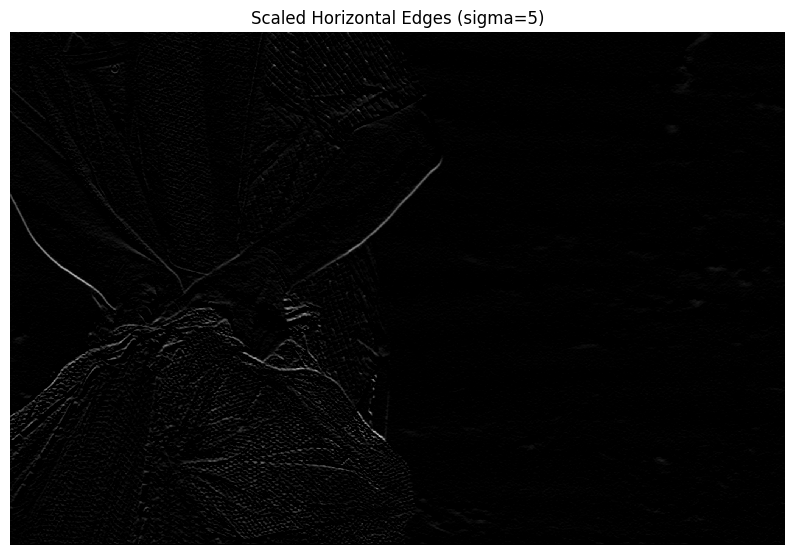

In [18]:
# Apply Sobel filters to image1
vertical_edges = conv(image3, sobel_vertical)
horizontal_edges = conv(image3, sobel_horizontal)

# Display results
display(vertical_edges, 'Vertical Edges')
print_stats(vertical_edges)

display(horizontal_edges, 'Horizontal Edges')
print_stats(horizontal_edges)

# Combine vertical and horizontal edges
edge_magnitude = np.sqrt(vertical_edges**2 + horizontal_edges**2)
edge_direction = np.arctan2(vertical_edges, horizontal_edges)

# Display combined results
display(edge_magnitude, 'Edge Magnitude')
print_stats(edge_magnitude)

# Display positive and negative gradients separately
positive_vertical = np.maximum(vertical_edges, 0)
negative_vertical = np.minimum(vertical_edges, 0)

display(positive_vertical, 'Positive Vertical Gradients')
display(negative_vertical, 'Negative Vertical Gradients')

# Apply at different scales by first blurring
blurred_image = conv(image3, guassian_kernel_5_5)
scaled_vertical = conv(blurred_image, sobel_vertical)
scaled_horizontal = conv(blurred_image, sobel_horizontal)

display(scaled_vertical, 'Scaled Vertical Edges (sigma=5)')
display(scaled_horizontal, 'Scaled Horizontal Edges (sigma=5)')


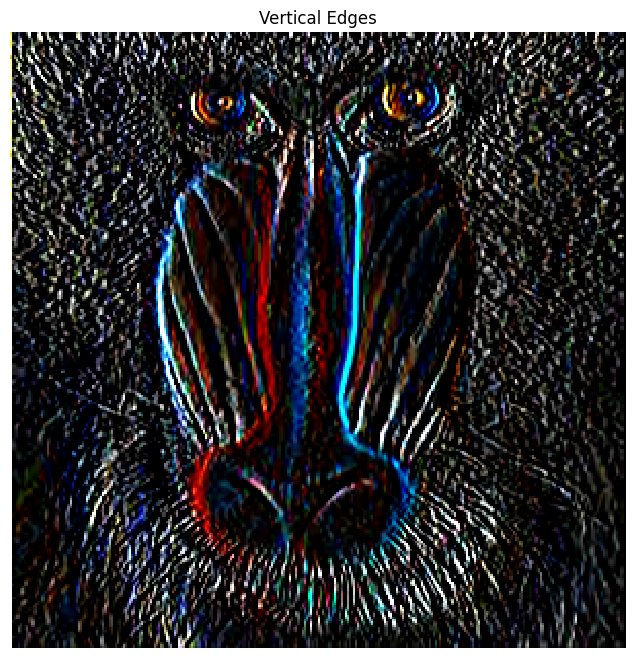

Height:  300
Width:  300
Channels:  3


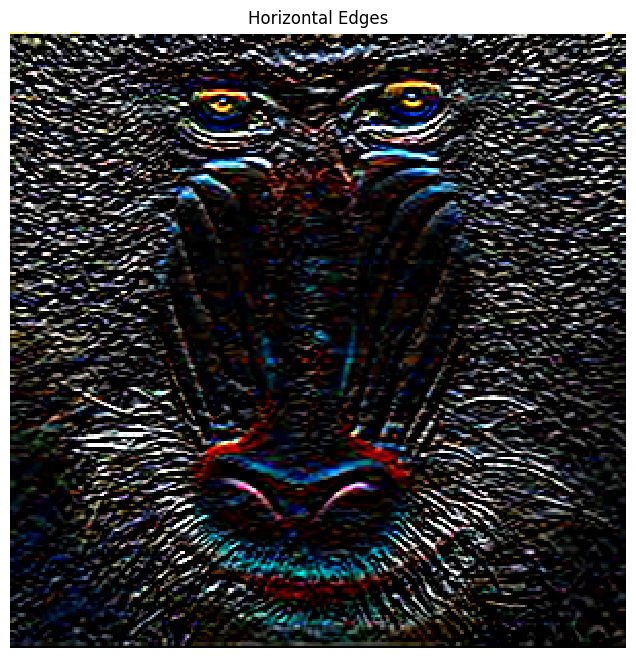

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.4142135623730951].


Height:  300
Width:  300
Channels:  3


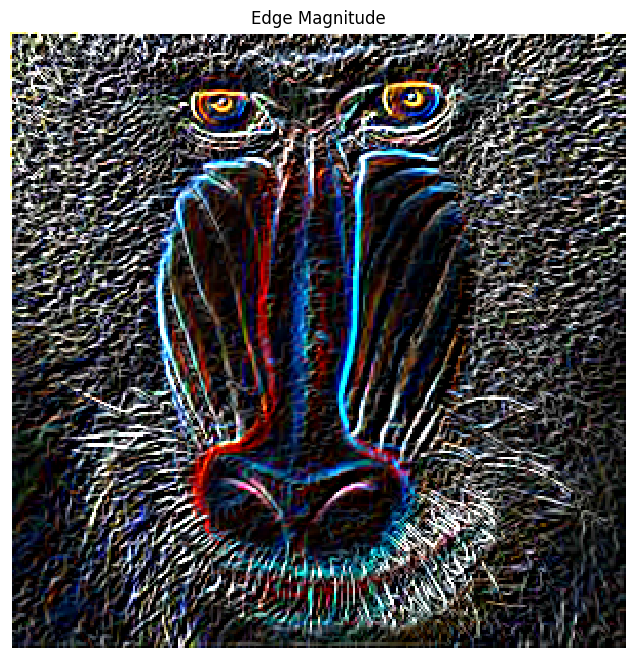

Height:  300
Width:  300
Channels:  3


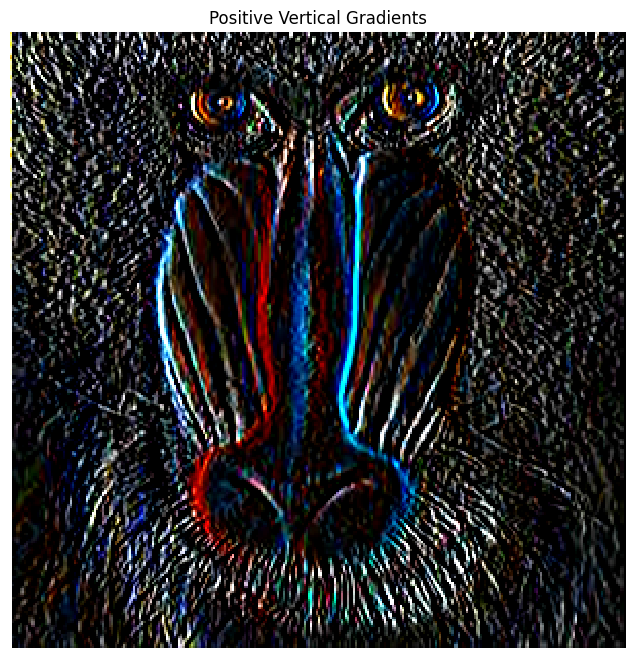

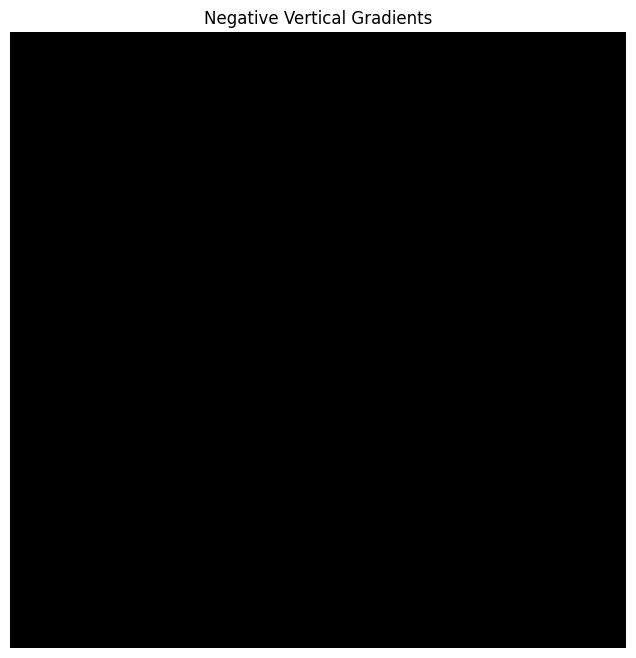

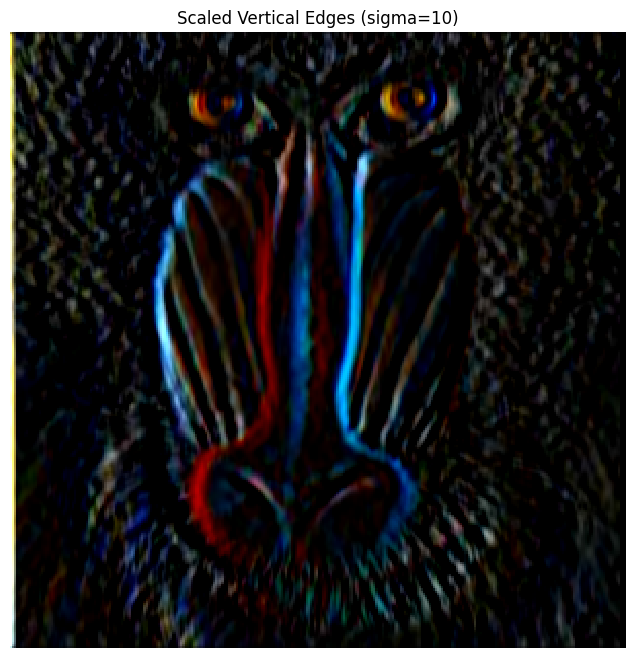

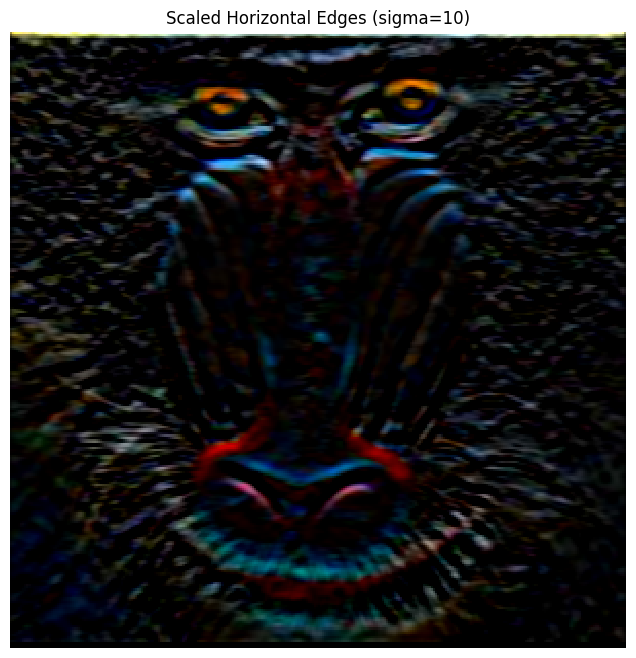

In [19]:
# Apply Sobel filters to image1
vertical_edges = conv(image4, sobel_vertical)
horizontal_edges = conv(image4, sobel_horizontal)

# Display results
display(vertical_edges, 'Vertical Edges')
print_stats(vertical_edges)

display(horizontal_edges, 'Horizontal Edges')
print_stats(horizontal_edges)

# Combine vertical and horizontal edges
edge_magnitude = np.sqrt(vertical_edges**2 + horizontal_edges**2)
edge_direction = np.arctan2(vertical_edges, horizontal_edges)

# Display combined results
display(edge_magnitude, 'Edge Magnitude')
print_stats(edge_magnitude)

# Display positive and negative gradients separately
positive_vertical = np.maximum(vertical_edges, 0)
negative_vertical = np.minimum(vertical_edges, 0)

display(positive_vertical, 'Positive Vertical Gradients')
display(negative_vertical, 'Negative Vertical Gradients')

# Apply at different scales by first blurring
blurred_image = conv(image4, guassian_kernel_5_10)
scaled_vertical = conv(blurred_image, sobel_vertical)
scaled_horizontal = conv(blurred_image, sobel_horizontal)

display(scaled_vertical, 'Scaled Vertical Edges (sigma=10)')
display(scaled_horizontal, 'Scaled Horizontal Edges (sigma=10)')

***Your comments/analysis of your results here...***

## Question 4: Image sampling and pyramids (30%)

### 4.1 Image Sampling

- Apply your `resize()` function to reduce an image (I) to 0.5\*height and 0.5\*width

- Repeat the above procedure, but apply a Gaussian blur filter to your original image before downsampling it. How does the result compare to your previous output, and to the original image? Why?


### 4.2 Image Pyramids
- Create a Gaussian pyramid as described in week2's lecture on an image.

- Apply a Gaussian kernel to an image I, and resize it with ratio 0.5, to get $I_1$. Repeat this step to get $I_2$, $I_3$ and $I_4$.

- Display these four images in a manner analogus to the example shown in the lectures.




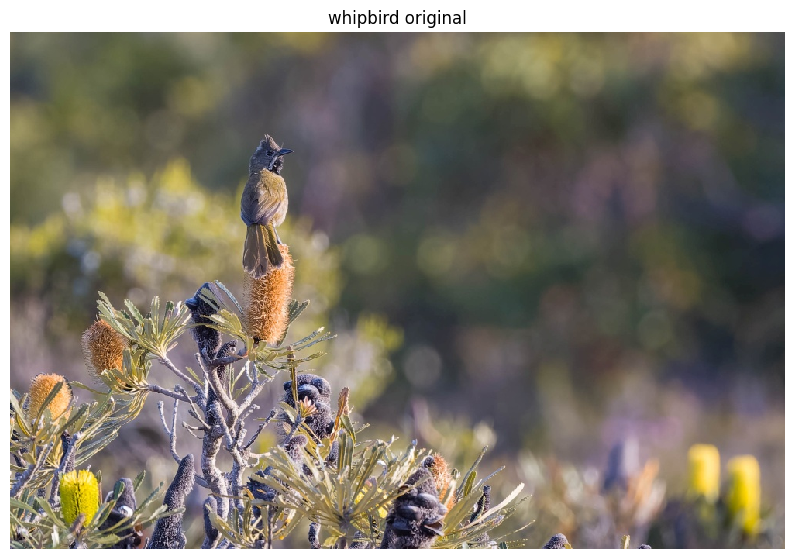

Height:  667
Width:  1000
Channels:  3


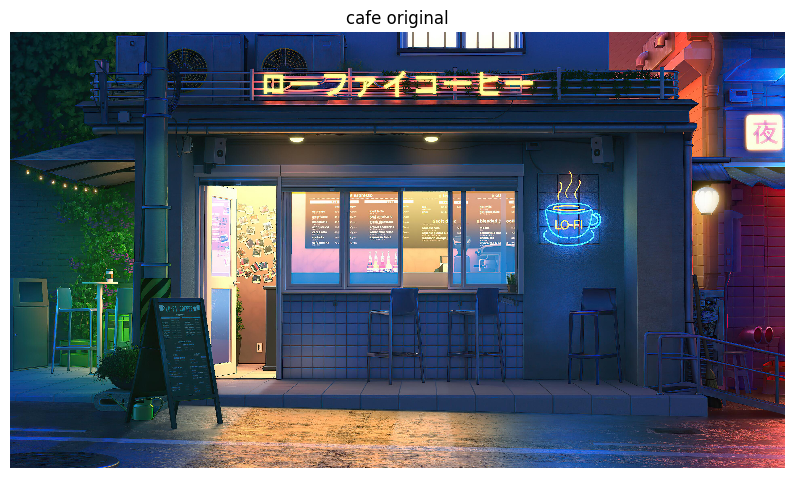

Height:  2160
Width:  3840
Channels:  3


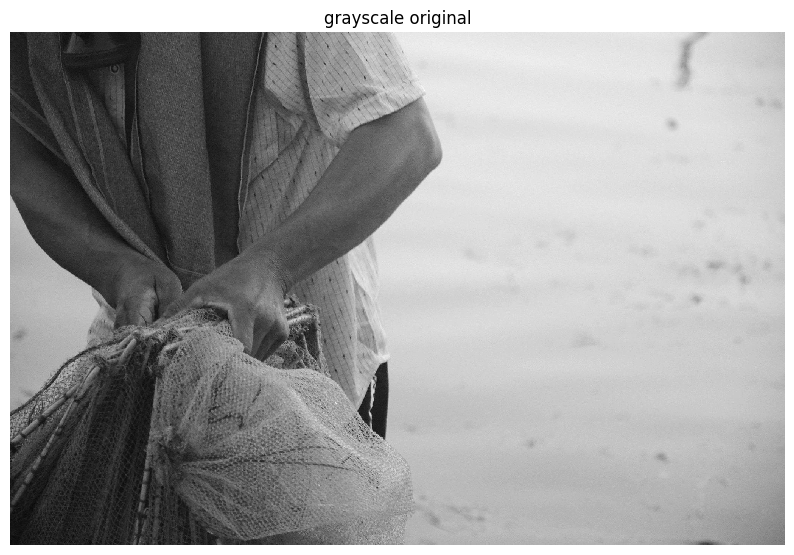

Height:  1356
Width:  2048
Channels: 1


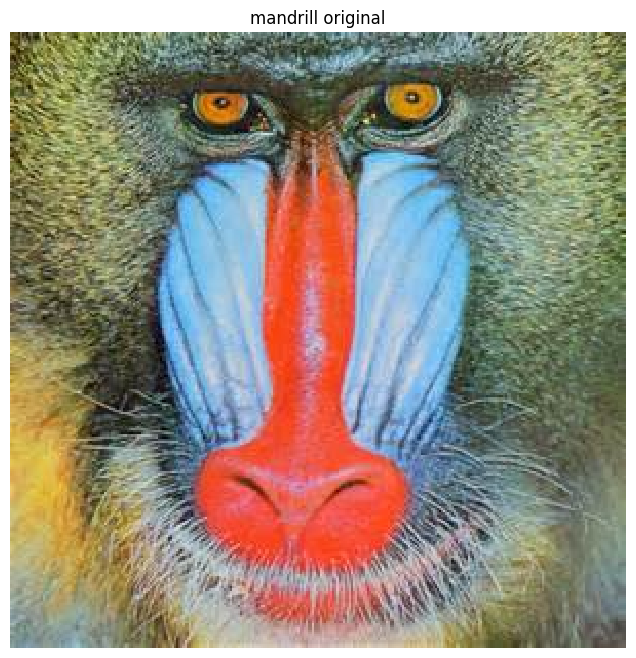

Height:  300
Width:  300
Channels:  3


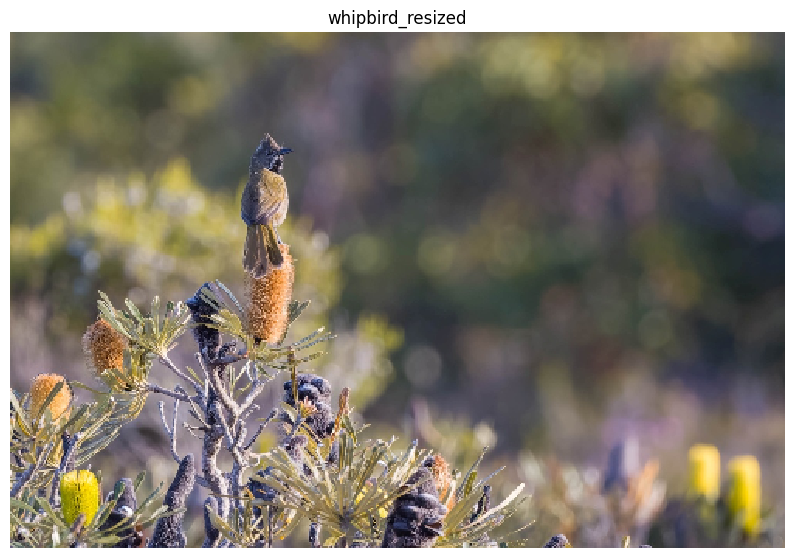

Height:  333
Width:  500
Channels:  3


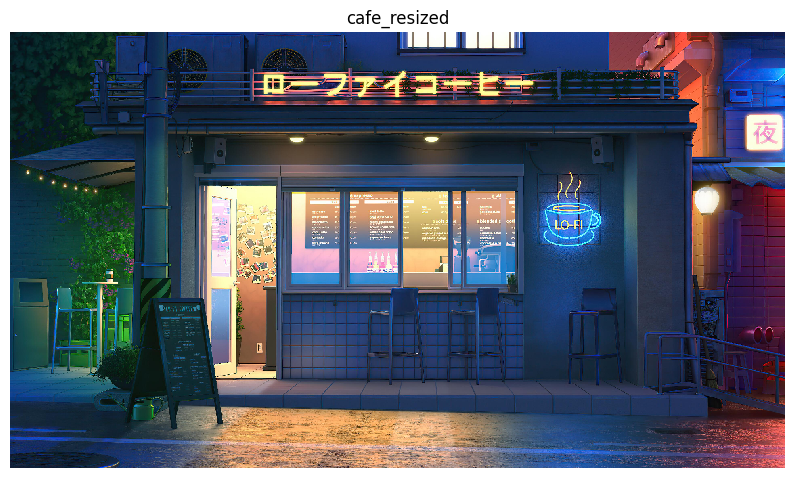

Height:  1080
Width:  1920
Channels:  3


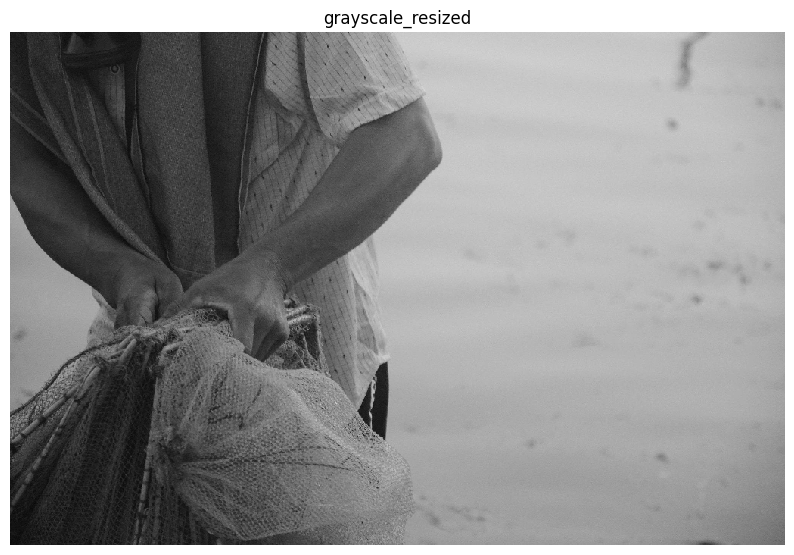

Height:  678
Width:  1024
Channels:  3


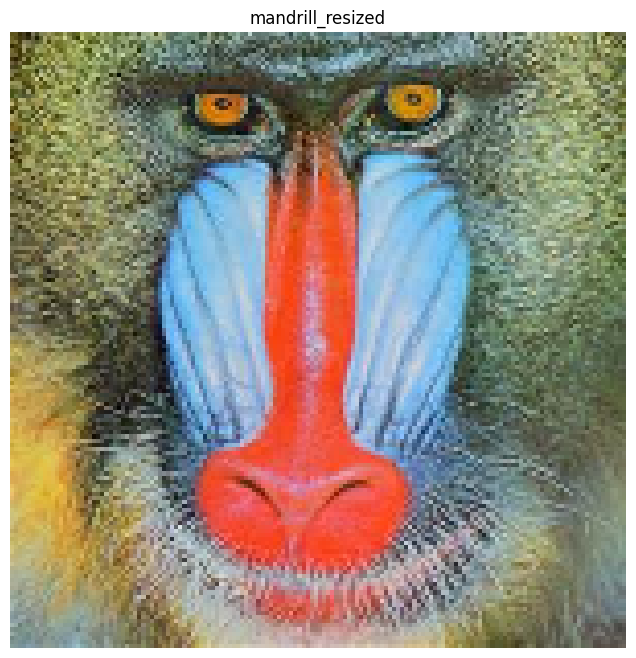

Height:  150
Width:  150
Channels:  3


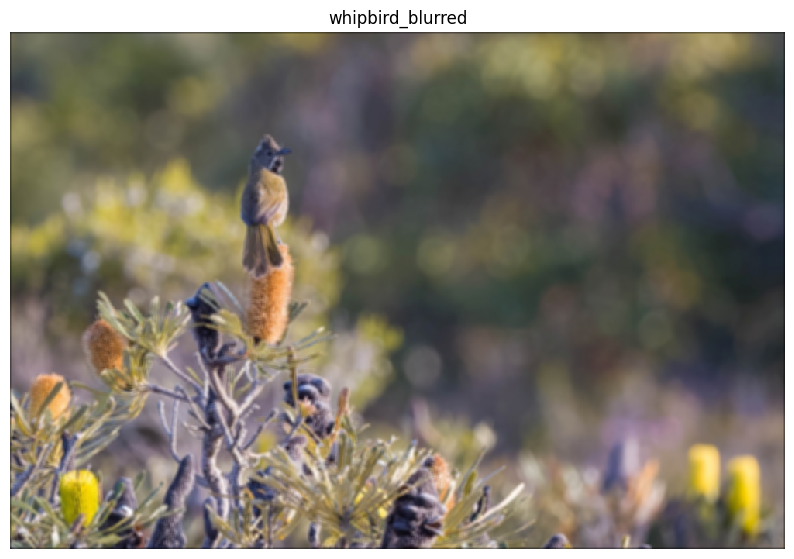

Height:  667
Width:  1000
Channels:  3


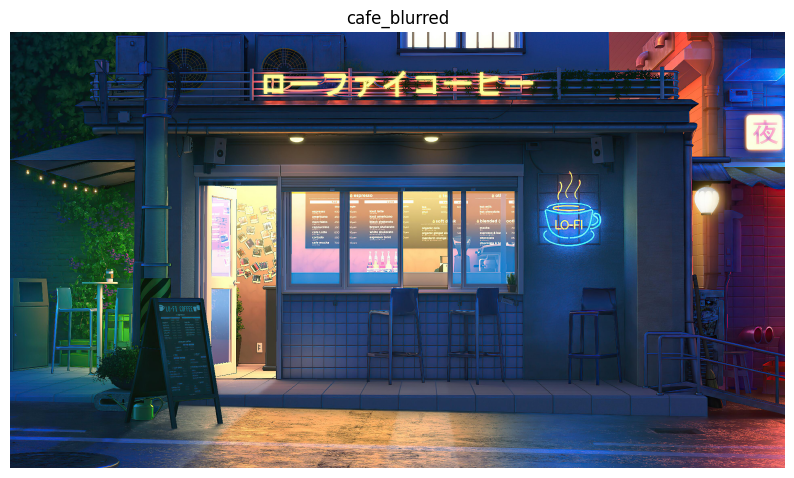

Height:  2160
Width:  3840
Channels:  3


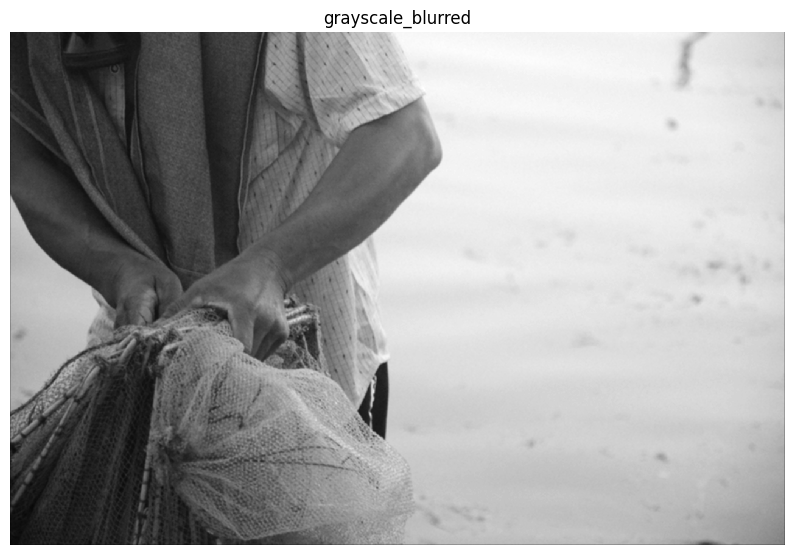

Height:  1356
Width:  2048
Channels: 1


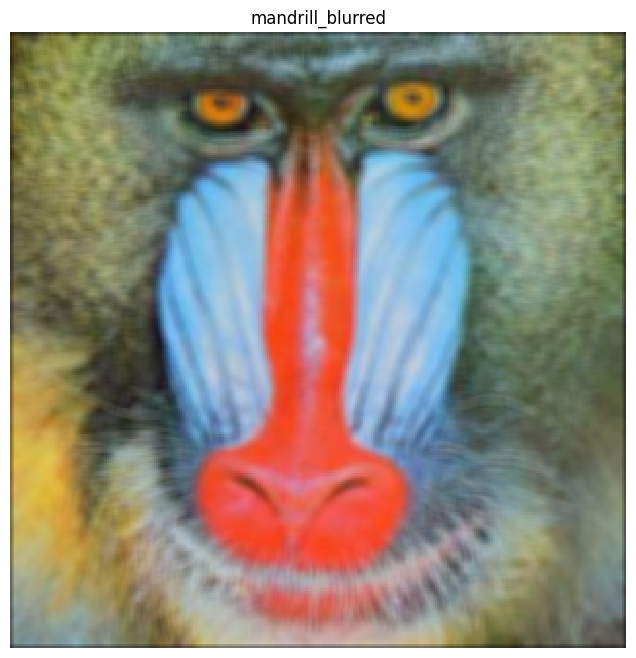

Height:  300
Width:  300
Channels:  3


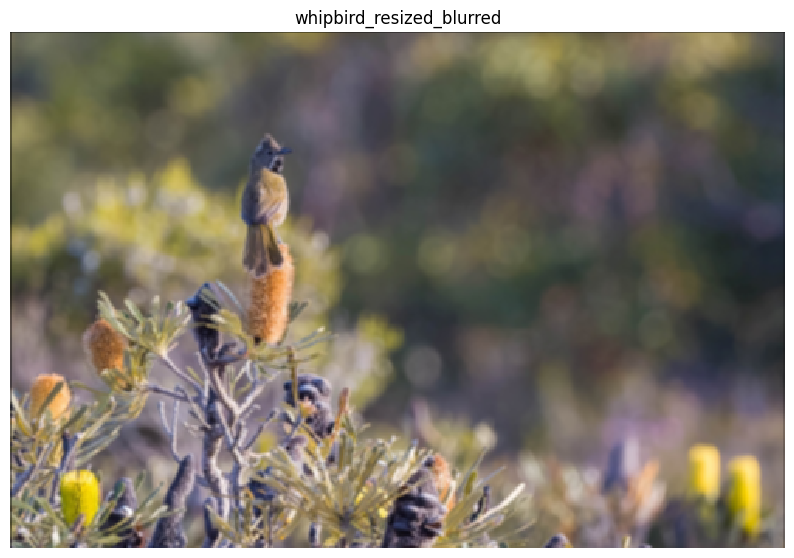

Height:  333
Width:  500
Channels:  3


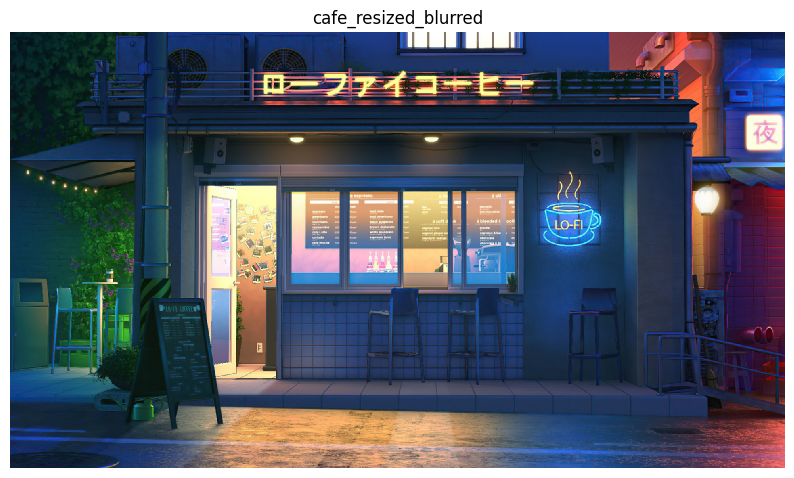

Height:  1080
Width:  1920
Channels:  3


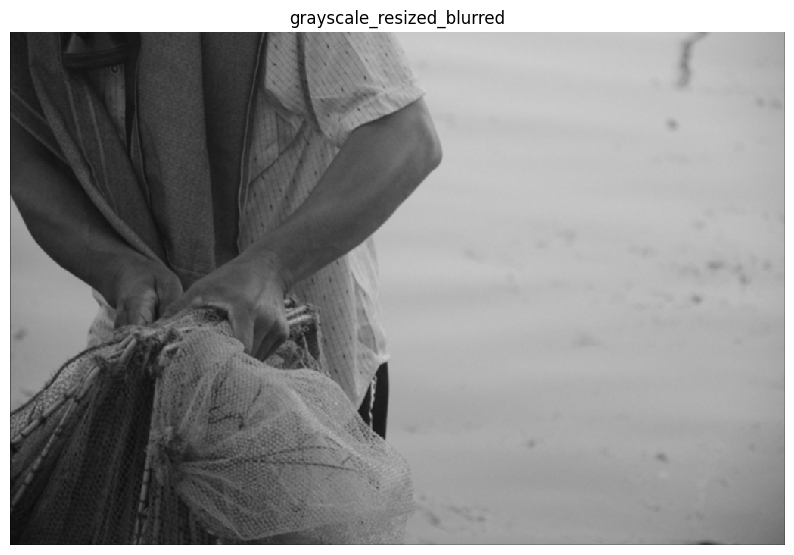

Height:  678
Width:  1024
Channels:  3


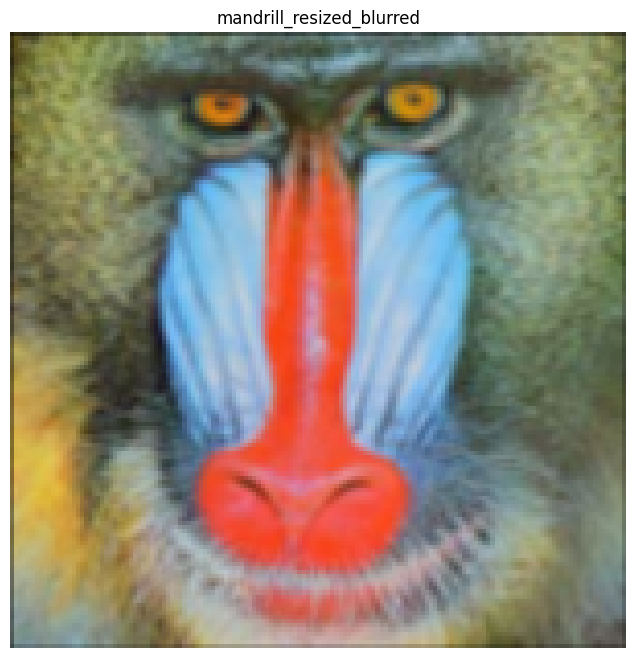

Height:  150
Width:  150
Channels:  3


In [20]:
# Your answers to question 4 here

# 4.1 image sampling
image1 = load('images/whipbird.jpg')
image2 = load('images/cafe.jpg')
image3 = load('images/grayscale.jpg')
image4 = load('images/mandrill.jpg')

image1_size = image1.shape
image2_size = image2.shape
image3_size = image3.shape
image4_size = image4.shape

desired_size_image1 = (image1_size[0]//2, image1_size[1]//2)
desired_size_image2 = (image2_size[0]//2, image2_size[1]//2)
desired_size_image3 = (image3_size[0]//2, image3_size[1]//2)
desired_size_image4 = (image4_size[0]//2, image4_size[1]//2)

image1_resized = resize(image1, desired_size_image1[0], desired_size_image1[1])
image2_resized = resize(image2, desired_size_image2[0], desired_size_image2[1])
image3_resized = resize(image3, desired_size_image3[0], desired_size_image3[1])
image4_resized = resize(image4, desired_size_image4[0], desired_size_image4[1])

display(image1, 'whipbird original')
print_stats(image1)
display(image2, 'cafe original')
print_stats(image2)
display(image3, 'grayscale original')
print_stats(image3)
display(image4, 'mandrill original')
print_stats(image4)

display(image1_resized, 'whipbird_resized')
print_stats(image1_resized)
display(image2_resized, 'cafe_resized')
print_stats(image2_resized)
display(image3_resized, 'grayscale_resized')
print_stats(image3_resized)
display(image4_resized, 'mandrill_resized')
print_stats(image4_resized)

## Blurred then resized

gaussian_kernel_5_10 = gauss2D(5, 10)
image1_blurred = conv(image1, guassian_kernel_5_10)
image2_blurred = conv(image2, guassian_kernel_5_10)
image3_blurred = conv(image3, guassian_kernel_5_10)
image4_blurred = conv(image4, guassian_kernel_5_10)

display(image1_blurred, 'whipbird_blurred')
print_stats(image1_blurred)
display(image2_blurred, 'cafe_blurred')
print_stats(image2_blurred)
display(image3_blurred, 'grayscale_blurred')
print_stats(image3_blurred)
display(image4_blurred, 'mandrill_blurred')
print_stats(image4_blurred)

image1_resized_blurred = resize(image1_blurred, desired_size_image1[0], desired_size_image1[1])
image2_resized_blurred = resize(image2_blurred, desired_size_image2[0], desired_size_image2[1])
image3_resized_blurred = resize(image3_blurred, desired_size_image3[0], desired_size_image3[1])
image4_resized_blurred = resize(image4_blurred, desired_size_image4[0], desired_size_image4[1])

display(image1_resized_blurred, 'whipbird_resized_blurred')
print_stats(image1_resized_blurred)
display(image2_resized_blurred, 'cafe_resized_blurred')
print_stats(image2_resized_blurred)
display(image3_resized_blurred, 'grayscale_resized_blurred')
print_stats(image3_resized_blurred)
display(image4_resized_blurred, 'mandrill_resized_blurred')
print_stats(image4_resized_blurred)



<Figure size 1000x800 with 0 Axes>

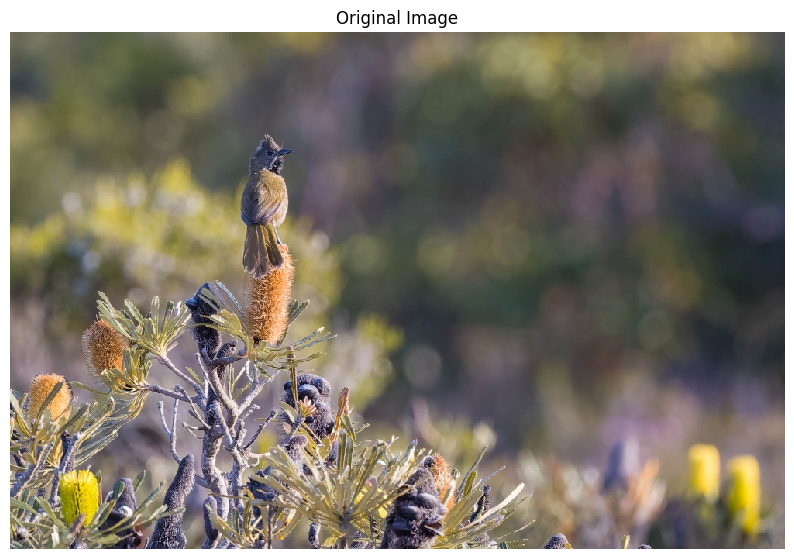

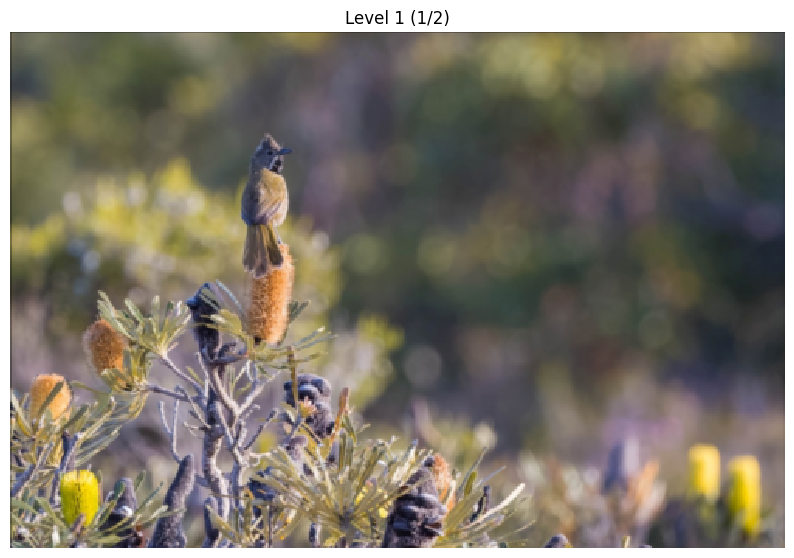

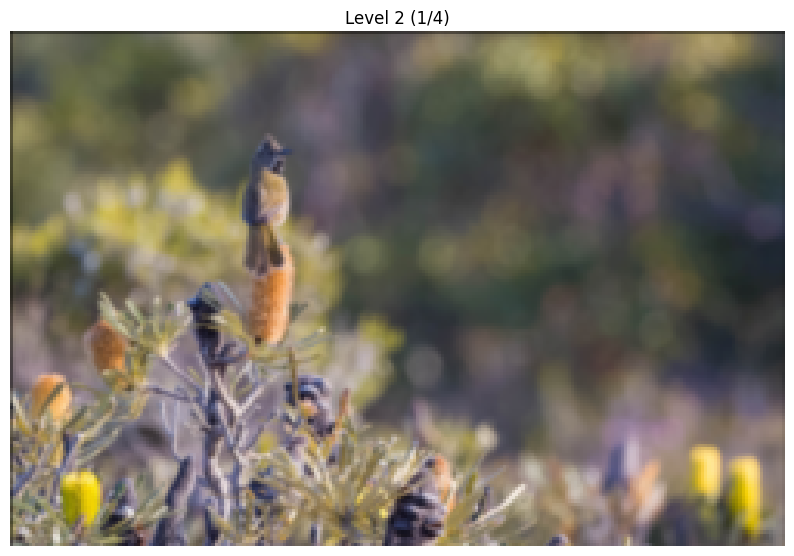

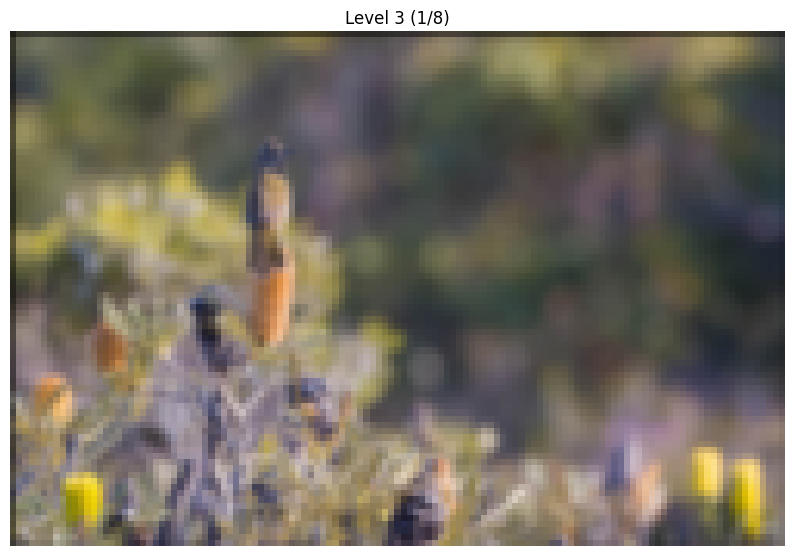

In [21]:
## 4.2 pyramid
# Create Gaussian pyramid for image1 (whipbird)
gaussian_kernel = gauss2D(5, 1)

# Original image I
I = load('images/whipbird.jpg')
height, width = I.shape[:2]

# I1 - First level (1/2 size)
I1 = conv(I, gaussian_kernel)
I1 = resize(I1, height//2, width//2)

# I2 - Second level (1/4 size) 
I2 = conv(I1, gaussian_kernel)
I2 = resize(I2, height//4, width//4)

# I3 - Third level (1/8 size)
I3 = conv(I2, gaussian_kernel)
I3 = resize(I3, height//8, width//8)

# I4 - Fourth level (1/16 size)
I4 = conv(I3, gaussian_kernel)
I4 = resize(I4, height//16, width//16)

# Display pyramid
plt.figure(figsize=(10, 8))

# Calculate total width and height needed
total_width = width
total_height = height

# Main image
display(I, 'Original Image')
display(I1, 'Level 1 (1/2)')
display(I2, 'Level 2 (1/4)')
display(I3, 'Level 3 (1/8)')



***Your comments/analysis of your results here...***

## Question 5: (optional, assesed for granting up to 20% bonus marks for the A1)

Image filtering lectures, particularly Lecture 2, have covered the details related to this question. This is a bonus question for the students to get opportunities to recover lost marks in the other parts of the assignment. **Note that the overall marks will be capped at 100%**.

### 5.1 Apply and analyse a blob detector

- Create a Laplacian of Gaussian (LoG) filter in the function `LoG2D()` and visualize its response on your images. You can use the template function (and hints therein) for the task if you wish.

- Modify parameters of the LoG filters and apply them to an image of your choice. Show how these variations are manifested in the output.

- Repeat the experiment by rescaling the image with a combination of appropriate filters designed by you for these assignment. What correlations do you find when changing the scale or modifying the filters?

- How does the response of LoG filter change when you rotate the image by 90 degrees? You can write a function to rotate the image or use an externally rotated image for this task.





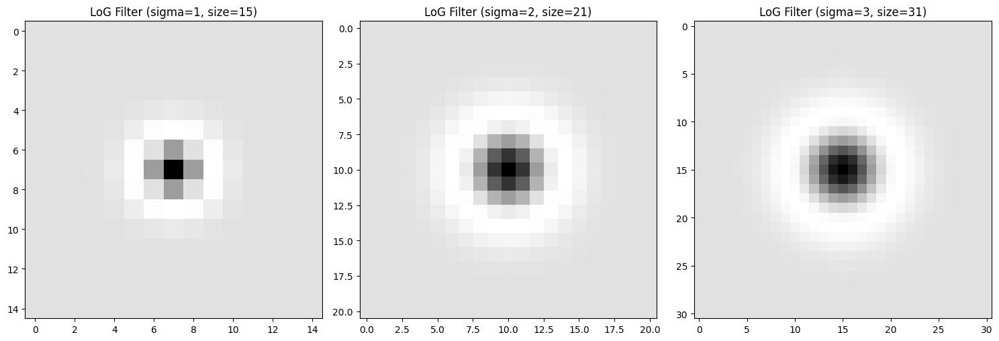

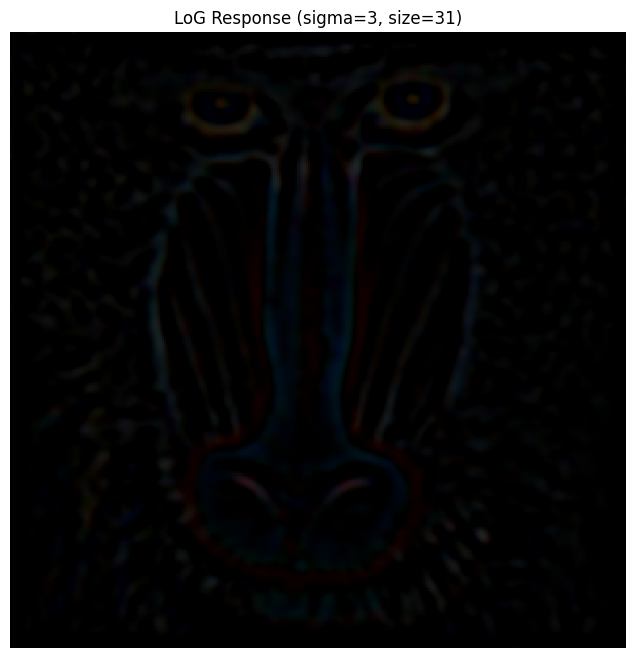

<Figure size 1500x500 with 0 Axes>

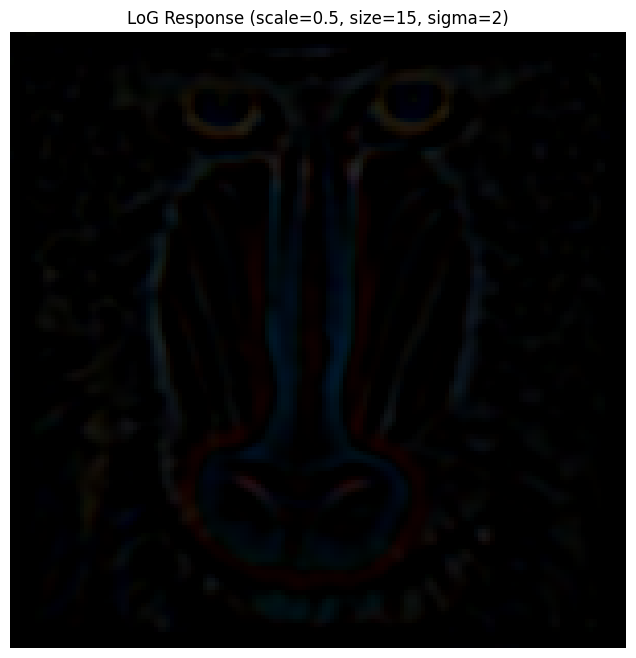

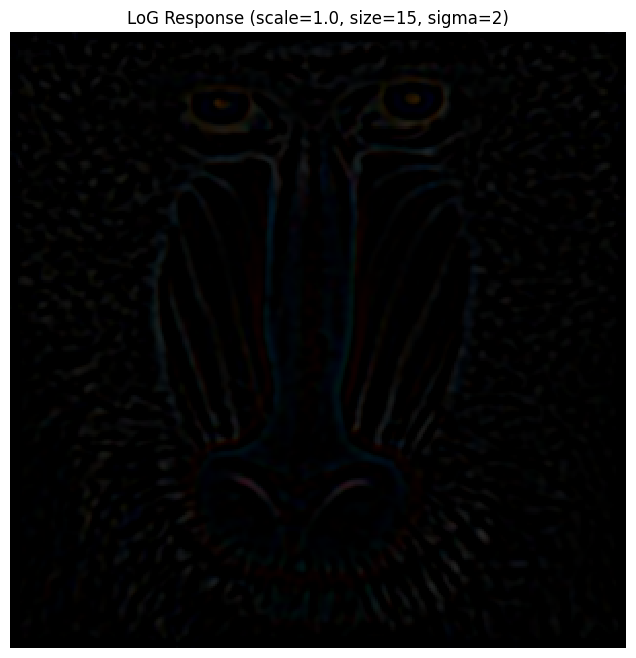

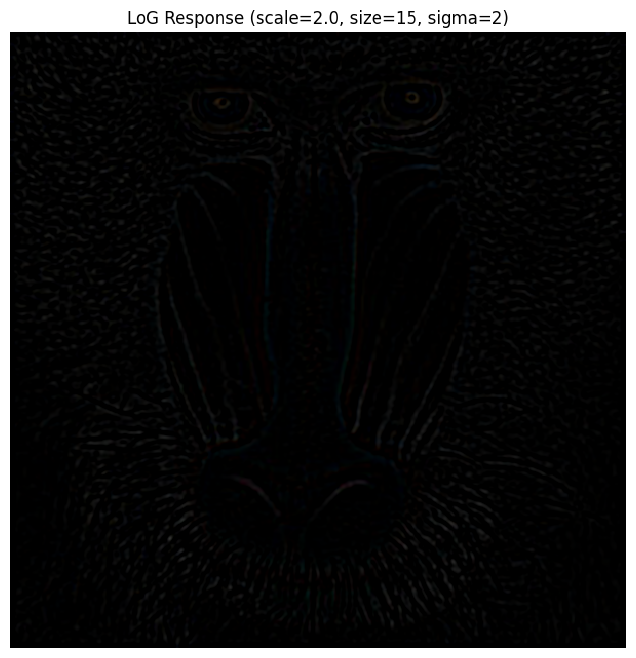

<Figure size 1500x500 with 0 Axes>

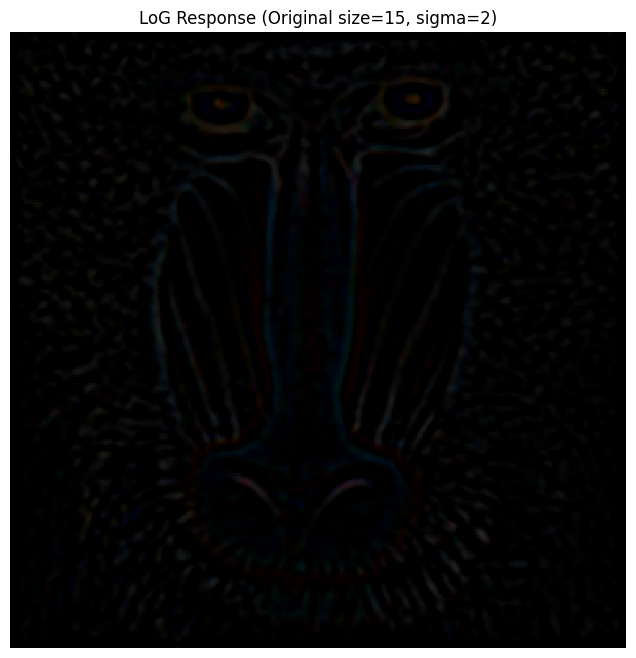

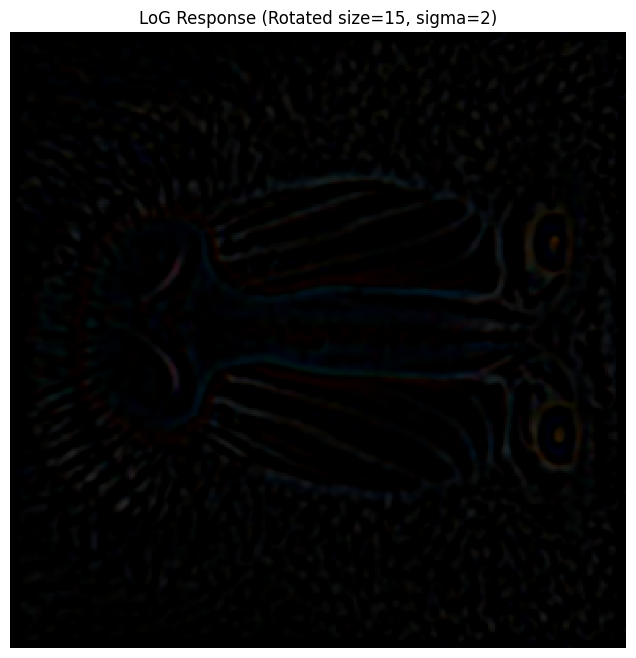

In [22]:
# Your code to answer question 5 and display results here

sigmas = [1, 2, 3]
sizes = [15, 21, 31]

# Visualize LoG filters with different sizes and sigmas
plt.figure(figsize=(15, 5))
for i, (sigma, size) in enumerate(zip(sigmas, sizes)):
    log_filter = LoG2D(size, sigma)
    plt.subplot(1, 3, i+1)
    plt.imshow(log_filter, cmap='gray')
    plt.title(f'LoG Filter (sigma={sigma}, size={size})')
plt.tight_layout()

# Apply LoG filter 
image = load('images/mandrill.jpg')
log_response = conv(image, LoG2D(31, 3))
display(log_response, 'LoG Response (sigma=3, size=31)')

# Test different scales
scales = [0.5, 1.0, 2.0]
plt.figure(figsize=(15, 5))
for i, scale in enumerate(scales):
    # Resize image
    new_rows = int(image.shape[0] * scale)
    new_cols = int(image.shape[1] * scale)
    scaled_image = resize(image, new_rows, new_cols)
    
    # Apply LoG filter with fixed parameters (for consistency)
    size = 15
    sigma = 2
    log_response_scaled = conv(scaled_image, LoG2D(size, sigma))
    display(log_response_scaled, f'LoG Response (scale={scale}, size={size}, sigma={sigma})')

# Test rotation
def rotate_image_90(image):
    """Rotate image 90 degrees clockwise"""
    return np.rot90(image, k=-1)

# Original and rotated responses
plt.figure(figsize=(15, 5))

# Original
log_response_original = conv(image, LoG2D(15, 2))
rotated_image = rotate_image_90(image)
log_response_rotated = conv(rotated_image, LoG2D(15, 2))

display(log_response_original, 'LoG Response (Original size=15, sigma=2)')
display(log_response_rotated, 'LoG Response (Rotated size=15, sigma=2)')
